# 06

In [ ]:
import os, sys 
import itertools
import collections
import random
import time 
import logging

from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
from matplotlib.pyplot import imread

import torch
import torch.nn as nn
from torch.utils.data import Dataset
from torchvision.transforms import ToTensor
from torch.optim import Adam, AdamW
from torch.optim.lr_scheduler import MultiStepLR
from torch.profiler import profile, record_function, ProfilerActivity

#########################################################################################################
torch.set_float32_matmul_precision('high')
DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
ROOT_PROJECT = "/home/jovyan/shared/Thuc/hoodsgatedrive/projects/ImageRestoration-Development-Unrolling/"
ROOT_DATASET = "/home/jovyan/shared/Thuc/hoodsgatedrive/projects/"

#########################################################################################################

sys.path.append(os.path.join(ROOT_PROJECT, 'exploration/model_multiscale_mixture_GLR/lib'))
from dataloader import ImageSuperResolution

LOG_DIR = os.path.join(ROOT_PROJECT, "exploration/model_multiscale_mixture_GLR/result/model_MMGLR_deep/logs/")
LOGGER = logging.getLogger("main")
logging.basicConfig(
    format='%(asctime)s: %(message)s', 
    datefmt='%m/%d/%Y %I:%M:%S %p',
    filename=os.path.join(LOG_DIR, 'training00.log'), 
    level=logging.INFO
)

CHECKPOINT_DIR = os.path.join(ROOT_PROJECT, "exploration/model_multiscale_mixture_GLR/result/model_MMGLR_deep/checkpoints/")
VERBOSE_RATE = 1000

(H_train, W_train) = (64, 64)
(H_val, W_val) = (128, 128)
(H_test, W_test) = (496, 496)

train_dataset = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/DFWB_training_data_info.csv"),
    dist_mode="vary_addictive_noise",
    lambda_noise=[[1.0, 10.0, 15.0, 20.0, 25.0], [0.1, 0.1, 0.1, 0.1, 0.6]],
    patch_size=(H_train, W_train),
    patch_overlap_size=(H_train//2, W_train//2),
    max_num_patchs=1000000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)

validation_dataset = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/CBSD68_testing_data_info.csv"),
    dist_mode="addictive_noise",
    lambda_noise=25.0,
    patch_size=(H_val, H_val),
    patch_overlap_size=(H_val//2, H_val//2),
    max_num_patchs=1000000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)

test_dataset = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/McMaster_testing_data_info.csv"),
    dist_mode="addictive_noise",
    lambda_noise=25.0,
    patch_size=(H_test, W_test),
    patch_overlap_size=(0, 0),
    max_num_patchs=1000000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)


data_train_batched = torch.utils.data.DataLoader(
    train_dataset, batch_size=16, num_workers=4
)

data_valid_batched = torch.utils.data.DataLoader(
    validation_dataset, batch_size=16, num_workers=4
)

data_test_batched = torch.utils.data.DataLoader(
    test_dataset, batch_size=1, num_workers=4
)

In [2]:
import itertools
import collections
import numpy as np
import torch
import torch.nn as nn
from torch.nn.parameter import Parameter
from torch.profiler import profile, record_function, ProfilerActivity
# torch.set_default_dtype(torch.float64)

from einops import rearrange


class CustomLayerNorm(nn.Module):
    def __init__(self, nchannels):
        super(CustomLayerNorm, self).__init__()
        
        self.nchannels = nchannels
        self.weighted_transform = nn.Conv2d(nchannels, nchannels, kernel_size=1, stride=1, groups=nchannels, bias=False)

    def forward(self, x):
        # bz, nchannels, h, w = x.shape
        sigma = x.var(dim=1, keepdim=True, correction=1)
        # bz, 1, h, w = sigma.shape
        return self.weighted_transform(x / torch.sqrt(sigma+1e-5))
    


##########################################################################
class FeedForward(nn.Module):
    def __init__(self, dim, ffn_expansion_factor, bias):
        super(FeedForward, self).__init__()

        hidden_features = int(dim*ffn_expansion_factor)
        # hidden_features = dim

        self.project_in = nn.Conv2d(dim, hidden_features*2, kernel_size=1, bias=bias)

        self.dwconv = nn.Conv2d(hidden_features*2, hidden_features*2, kernel_size=3, stride=1, padding=1, groups=hidden_features*2, bias=bias)

        self.project_out = nn.Conv2d(hidden_features, dim, kernel_size=1, bias=bias)

    def forward(self, x):
        x = self.project_in(x)
        x1, x2 = self.dwconv(x).chunk(2, dim=1)
        x = nn.functional.gelu(x1) * x2
        x = self.project_out(x)
        return x


##########################################################################
class FFBlock(nn.Module):
    def __init__(self, dim, ffn_expansion_factor, bias):
        super(FFBlock, self).__init__()

        self.norm = CustomLayerNorm(dim)

        self.skip_connect_weight_final = Parameter(
            torch.ones((2), dtype=torch.float32) * torch.tensor([0.5, 0.5]),
            requires_grad=True
        )
        self.ffn = FeedForward(dim, ffn_expansion_factor, bias)

    def forward(self, x):
        x = self.skip_connect_weight_final[0]*x + self.skip_connect_weight_final[1]*self.ffn(self.norm(x))

        return x



##########################################################################
## Overlapped image patch embedding with 3x3 Conv
class OverlapPatchEmbed(nn.Module):
    def __init__(self, in_c=3, embed_dim=48, bias=False):
        super(OverlapPatchEmbed, self).__init__()

        self.proj = nn.Conv2d(in_c, embed_dim, kernel_size=3, stride=1, padding=1, bias=bias)

    def forward(self, x):
        x = self.proj(x)

        return x



##########################################################################
## Resizing modules
class Downsample(nn.Module):
    def __init__(self, n_feat):
        super(Downsample, self).__init__()

        self.body = nn.Sequential(nn.Conv2d(n_feat, n_feat//2, kernel_size=3, stride=1, padding=1, bias=False),
                                  nn.PixelUnshuffle(2))

    def forward(self, x):
        return self.body(x)

class Upsample(nn.Module):
    def __init__(self, n_feat):
        super(Upsample, self).__init__()

        self.body = nn.Sequential(nn.Conv2d(n_feat, n_feat*2, kernel_size=3, stride=1, padding=1, bias=False),
                                  nn.PixelShuffle(2))

    def forward(self, x):
        return self.body(x)

##########################################################################
class FeatureExtraction(nn.Module):
    def __init__(self, 
        inp_channels=3, 
        out_channels=48, 
        dim = 48,
        num_blocks = [1,2,2,4], 
        num_refinement_blocks = 4,
        ffn_expansion_factor = 2.66,
        bias = False,
    ):

        super(FeatureExtraction, self).__init__()

        self.patch_embed = OverlapPatchEmbed(inp_channels, dim)

        self.encoder_level1 = nn.Sequential(*[FFBlock(dim=dim, ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[0])])
        
        self.down1_2 = Downsample(dim) ## From Level 1 to Level 2
        self.encoder_level2 = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[1])])
        
        self.down2_3 = Downsample(int(dim*2**1)) ## From Level 2 to Level 3
        self.encoder_level3 = nn.Sequential(*[FFBlock(dim=int(dim*2**2), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[2])])

        self.down3_4 = Downsample(int(dim*2**2)) ## From Level 3 to Level 4
        self.latent = nn.Sequential(*[FFBlock(dim=int(dim*2**3), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[3])])
        
        self.up4_3 = Upsample(int(dim*2**3)) ## From Level 4 to Level 3
        self.reduce_chan_level3 = nn.Conv2d(int(dim*2**3), int(dim*2**2), kernel_size=1, bias=bias)
        self.decoder_level3 = nn.Sequential(*[FFBlock(dim=int(dim*2**2), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[2])])


        self.up3_2 = Upsample(int(dim*2**2)) ## From Level 3 to Level 2
        self.reduce_chan_level2 = nn.Conv2d(int(dim*2**2), int(dim*2**1), kernel_size=1, bias=bias)
        self.decoder_level2 = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[1])])
        
        self.up2_1 = Upsample(int(dim*2**1))  ## From Level 2 to Level 1  (NO 1x1 conv to reduce channels)

        self.decoder_level1 = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[0])])
        
        self.refinement = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_refinement_blocks)])

        ###########################
        self.output = nn.Conv2d(int(dim*2**1), out_channels, kernel_size=3, stride=1, padding=1, bias=bias)

    def forward(self, inp_img):

        inp_enc_level1 = self.patch_embed(inp_img)
        out_enc_level1 = self.encoder_level1(inp_enc_level1)
        
        inp_enc_level2 = self.down1_2(out_enc_level1)
        out_enc_level2 = self.encoder_level2(inp_enc_level2)

        inp_enc_level3 = self.down2_3(out_enc_level2)
        out_enc_level3 = self.encoder_level3(inp_enc_level3) 

        inp_enc_level4 = self.down3_4(out_enc_level3)        
        latent = self.latent(inp_enc_level4) 
                        
        inp_dec_level3 = self.up4_3(latent)
        inp_dec_level3 = torch.cat([inp_dec_level3, out_enc_level3], 1)
        inp_dec_level3 = self.reduce_chan_level3(inp_dec_level3)
        out_dec_level3 = self.decoder_level3(inp_dec_level3) 

        inp_dec_level2 = self.up3_2(out_dec_level3)
        inp_dec_level2 = torch.cat([inp_dec_level2, out_enc_level2], 1)
        inp_dec_level2 = self.reduce_chan_level2(inp_dec_level2)
        out_dec_level2 = self.decoder_level2(inp_dec_level2) 

        inp_dec_level1 = self.up2_1(out_dec_level2)
        inp_dec_level1 = torch.cat([inp_dec_level1, out_enc_level1], 1)
        out_dec_level1 = self.decoder_level1(inp_dec_level1)
        
        out_dec_level1 = self.refinement(out_dec_level1)
        out_dec_level1 = self.output(out_dec_level1)

        # return [latent, out_dec_level3, out_dec_level2, out_dec_level1]
        return [out_dec_level1, out_dec_level2, out_dec_level3, latent]


class GLRFast(nn.Module):
    def __init__(self, 
            n_channels, n_node_fts, n_graphs, connection_window, device, M_diag_init=0.4
        ):
        super(GLRFast, self).__init__()

        self.device = device
        self.n_channels        = n_channels
        self.n_node_fts        = n_node_fts
        self.n_graphs          = n_graphs
        self.n_edges           = (connection_window == 1).sum()
        self.connection_window = connection_window
        self.buffer_size       = connection_window.sum()

        # edges type from connection_window
        window_size = connection_window.shape[0]
        connection_window = connection_window.reshape((-1))
        m = np.arange(window_size)-window_size//2
        edge_delta = np.array(
            list(itertools.product(m, m)),
            dtype=np.int32
        )
        self.edge_delta = edge_delta[connection_window == 1]
        
        self.pad_dim_hw = np.abs(self.edge_delta.min(axis=0))


        ### Trainable parameters
        # features on nodes #self.n_node_fts
        self.multiM = Parameter(
            torch.ones((self.n_graphs, self.n_node_fts), device=self.device, dtype=torch.float32)*M_diag_init,
            requires_grad=True,
        )


    def get_neighbors_pixels(self, img_features):
        _, _, H, W = img_features.shape
        padH, padW = self.pad_dim_hw
        img_features_frame = nn.functional.pad(img_features, (padW, padW, padH, padH), "replicate")
        neighbors_pixels = []
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            neighbors_pixels.append(
                img_features_frame[:, :, fromh:toh, fromw:tow]
            )
        neighbors_pixels_features = torch.stack(neighbors_pixels, axis=-3)

        return neighbors_pixels_features
    

    def normalize_and_transform_features(self, img_features):
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape
        # img_features = img_features.view(batch_size, self.n_graphs, self.n_node_fts, h_size, w_size)
        img_features = torch.nn.functional.normalize(img_features, dim=2)

        img_features_transform = torch.einsum(
            "bhcHW, hc -> bhcHW", img_features, self.multiM
        )
    
        img_features_transform = img_features_transform.view(batch_size, self.n_graphs*self.n_node_fts, h_size, w_size)

        return img_features_transform


    def extract_edge_weights(self, img_features):
        
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape

        img_features = self.normalize_and_transform_features(img_features)
        img_features_neighbors = self.get_neighbors_pixels(img_features)

        features_similarity = (img_features[:, :, None, :, :] * img_features_neighbors)
        features_similarity = features_similarity.view(
            batch_size, self.n_graphs, self.n_node_fts, self.n_edges, h_size, w_size
        ).sum(axis=2)

        edge_weights_norm = nn.functional.softmax(features_similarity, dim=2) 
        node_degree = edge_weights_norm.sum(axis=2)

        return edge_weights_norm, node_degree
    


    def op_L_norm(self, img_signals, edge_weights, node_degree):

        batch_size, n_graphs, n_channels, h_size, w_size = img_signals.shape
        img_features_neighbors = self.get_neighbors_pixels(
            img_signals.view(batch_size, n_graphs*n_channels, h_size, w_size)
        ).view(batch_size, n_graphs, n_channels, self.n_edges, h_size, w_size)
        Wx = torch.einsum(
            "bhceHW, bheHW -> bhcHW", img_features_neighbors, edge_weights
        )
        output = img_signals - Wx
        return output

    def forward(self, patchs, edge_weights, node_degree):
        output_patchs = self.op_L_norm(patchs, edge_weights, node_degree)
        return output_patchs
    



class GTVFast(nn.Module):
    def __init__(self, 
            n_channels, n_node_fts, n_graphs, connection_window, device, M_diag_init=0.4
        ):
        super(GTVFast, self).__init__()

        self.device = device
        self.n_channels        = n_channels
        self.n_node_fts        = n_node_fts
        self.n_graphs          = n_graphs
        self.n_edges           = (connection_window == 1).sum()
        self.connection_window = connection_window
        self.buffer_size       = connection_window.sum()

        # edges type from connection_window
        window_size = connection_window.shape[0]
        connection_window = connection_window.reshape((-1))
        m = np.arange(window_size)-window_size//2
        edge_delta = np.array(
            list(itertools.product(m, m)),
            dtype=np.int32
        )
        self.edge_delta = edge_delta[connection_window == 1]
        
        self.pad_dim_hw = np.abs(self.edge_delta.min(axis=0))


        ### Trainable parameters
        # features on nodes #self.n_node_fts
        self.multiM = Parameter(
            torch.ones((self.n_graphs, self.n_node_fts), device=self.device, dtype=torch.float32)*M_diag_init,
            requires_grad=True,
        )
        ############
        # avg_kernel = 1.0 * torch.tensor([
        #     [0.0, 0.0, 0.0],
        #     [0.0, 1.0, 0.0],
        #     [0.0, 0.0, 0.0],
        # ])
        # kernel = []
        # for r in range(self.n_channels):
        #     kernel.append(avg_kernel[np.newaxis, np.newaxis, :, :])

        # kernel = torch.concat(kernel, axis=0).to(self.device)
        # self.stats_kernel = Parameter(
        #     torch.ones((self.n_channels, 1, 3, 3), device=self.device, dtype=torch.float32) * kernel,
        #     requires_grad=True,
        # )

    def get_neighbors_pixels(self, img_features):
        _, _, H, W = img_features.shape
        padH, padW = self.pad_dim_hw
        img_features_frame = nn.functional.pad(img_features, (padW, padW, padH, padH), "replicate")
        neighbors_pixels = []
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            neighbors_pixels.append(
                img_features_frame[:, :, fromh:toh, fromw:tow]
            )
        neighbors_pixels_features = torch.stack(neighbors_pixels, axis=-3)

        return neighbors_pixels_features
    

    def normalize_and_transform_features(self, img_features):
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape
        # img_features = img_features.view(batch_size, self.n_graphs, self.n_node_fts, h_size, w_size)
        img_features = torch.nn.functional.normalize(img_features, dim=2)

        img_features_transform = torch.einsum(
            "bhcHW, hc -> bhcHW", img_features, self.multiM
        )
    
        img_features_transform = img_features_transform.view(batch_size, self.n_graphs*self.n_node_fts, h_size, w_size)

        return img_features_transform


    def extract_edge_weights(self, img_features):
        
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape

        img_features = self.normalize_and_transform_features(img_features)
        img_features_neighbors = self.get_neighbors_pixels(img_features)

        features_similarity = (img_features[:, :, None, :, :] * img_features_neighbors)
        features_similarity = features_similarity.view(
            batch_size, self.n_graphs, self.n_node_fts, self.n_edges, h_size, w_size
        ).sum(axis=2)

        edge_weights_norm = nn.functional.softmax(features_similarity, dim=2) 
        node_degree = edge_weights_norm.sum(axis=2)

        return edge_weights_norm, node_degree
    
    # def stats_conv(self, patchs):
    #     batch_size, n_graphs, c_size, h_size, w_size = patchs.shape
    #     temp_patch = patchs.view(batch_size*n_graphs, c_size, h_size, w_size)
    #     temp_patch = nn.functional.pad(temp_patch, (1,1,1,1), 'reflect')
    #     temp_out_patch = nn.functional.conv2d(
    #         temp_patch,
    #         weight=self.stats_kernel,
    #         stride=1,
    #         padding=0,
    #         dilation=1,
    #         groups=self.n_channels,
    #     )
    #     out_patch = temp_out_patch.view(batch_size, n_graphs, c_size, h_size, w_size)
    #     return out_patch

    # def stats_conv_transpose(self, patchs):
    #     batch_size, n_graphs, c_size, h_size, w_size = patchs.shape
    #     temp_patch = patchs.reshape(batch_size*n_graphs, c_size, h_size, w_size)
    #     temp_out_patch = nn.functional.conv_transpose2d(
    #         temp_patch,
    #         weight=self.stats_kernel,
    #         stride=1,
    #         padding=1,
    #         dilation=1,
    #         groups=self.n_channels,
    #     )
    #     out_patch = temp_out_patch.view(batch_size, n_graphs, c_size, h_size, h_size)
    #     return out_patch

    def op_C(self, img_signals, edge_weights, node_degree):


        batch_size, n_graphs, n_channels, h_size, w_size = img_signals.shape
        # img_signals = self.stats_conv(img_signals)

        img_features_neighbors = self.get_neighbors_pixels(
            img_signals.view(batch_size, n_graphs*n_channels, h_size, w_size)
        ).view(batch_size, n_graphs, n_channels, self.n_edges, h_size, w_size)
        Cx1 = img_signals[:, :, :, None, :, :] * edge_weights[:, :, None, :, :, :]
        Cx2 = img_features_neighbors * edge_weights[:, :, None, :, :, :]
        
        output = Cx1 - Cx2

        return output
    
    def op_C_transpose(self, edge_signals, edge_weights, node_degree):

        batch_size, n_graphs, n_channels, n_edges, H, W = edge_signals.shape
        edge_signals = edge_signals * edge_weights[:, :, None, :, :, :]

        output = edge_signals.sum(axis=3)

        padH, padW = self.pad_dim_hw
        output = nn.functional.pad(
            output.view(batch_size, n_graphs*n_channels, H, W),
            (padW, padW, padH, padH), "replicate"
        ).view(batch_size, n_graphs, n_channels, H + 2*padH, W + 2*padW)

        i=0
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            output[:, :, :, fromh:toh, fromw:tow] = output[:, :, :, fromh:toh, fromw:tow] - edge_signals[:, :, :, i, :, :]
            i+=1

        output = output[:, :, :, padH:-padH, padW:-padW]

        # output = self.stats_conv_transpose(output)
        return output

    def forward(self, patchs, edge_weights, node_degree):
        # C^T C
        edges_signals = self.op_C(patchs, edge_weights, node_degree)
        output_patchs = self.op_C_transpose(edges_signals, edge_weights, node_degree)

        return output_patchs
    
class MixtureGTV(nn.Module):
    def __init__(self, 
            nchannels_in,
            n_graphs,
            n_node_fts,
            connection_window,
            n_cgd_iters,
            alpha_init,
            beta_init,
            muy_init, ro_init, gamma_init,
            device
        ):
        super(MixtureGTV, self).__init__()

        self.device       = device
        self.n_graphs     = n_graphs
        self.n_node_fts   = n_node_fts
        self.n_total_fts  = n_graphs * n_node_fts
        self.n_levels     = 4
        self.n_cgd_iters  = n_cgd_iters
        self.nchannels_in = nchannels_in
        self.connection_window = connection_window

        self.alphaCGD =  Parameter(
            torch.ones((self.n_cgd_iters, n_graphs), device=self.device, dtype=torch.float32) * alpha_init,
            requires_grad=True
        )

        self.betaCGD =  Parameter(
            torch.ones((self.n_cgd_iters, n_graphs), device=self.device, dtype=torch.float32) * beta_init,
            requires_grad=True
        )

        self.patchs_features_extraction = FeatureExtraction(
            inp_channels=3, 
            out_channels=self.n_total_fts, 
            dim = self.n_total_fts,
            num_blocks = [2, 2, 2, 2], 
            num_refinement_blocks = 4,
            ffn_expansion_factor = 1,
            bias = False,
        ).to(self.device)
        
        self.combination_weight = nn.Sequential(
            nn.Conv2d(
                in_channels=self.n_total_fts, 
                out_channels=self.n_graphs, 
                kernel_size=1,
                stride=1,
                padding=0,
                padding_mode="zeros",
                bias=False
            ),
            nn.Softmax(dim=1)
        ).to(self.device)

        self.ro00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * ro_init[0],
            requires_grad=True,
        )
        self.gamma00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * torch.log(gamma_init[0]),
            requires_grad=True,
        )
        self.GTVmodule00 = GTVFast(
            n_channels=self.nchannels_in,
            n_node_fts=self.n_node_fts,
            n_graphs=self.n_graphs,
            connection_window=self.connection_window,
            device=self.device,
            M_diag_init=1.0
        )

        self.muys00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * muy_init[0],
            requires_grad=True,
        )
        self.GLRmodule00 = GLRFast(
            n_channels=self.nchannels_in,
            n_node_fts=self.n_node_fts,
            n_graphs=self.n_graphs,
            connection_window=self.connection_window,
            device=self.device,
            M_diag_init=1.0
        )

    def apply_lightweight_transformer(self, patchs, list_graph_weightGTV, list_graph_weightGLR):

        batch_size, n_graphs, c_size, h_size, w_size = patchs.shape 
        patchs = patchs.contiguous()
        graph_weights, graph_degree = list_graph_weightGLR[0]

        Lpatchs = self.GLRmodule00(patchs, graph_weights, graph_degree)
        Lpatchs = torch.einsum(
            "bHchw, H -> bHchw", Lpatchs, self.muys00
        )

        graph_weights, graph_degree = list_graph_weightGTV[0]
        CtCpatchs = self.GTVmodule00(patchs, graph_weights, graph_degree)
        CtCpatchs = torch.einsum(
            "bHchw, H -> bHchw", CtCpatchs, self.ro00
        )

        output = patchs + Lpatchs + CtCpatchs

        return output
    
    def soft_threshold(self, delta, gamma):
        # batch_size, n_graphs, n_channels, n_edges, H, W = delta.shape
        # n_graphs = gamma.shape

        gamma = gamma[None, :, None, None, None, None]
        # print(f"Gamma.shape={gamma.shape}")

        condA = (delta < -gamma) 
        outputA = torch.where(
            condA,
            delta+gamma,
            0.0
        )
        condB = (delta > gamma) 
        outputB = torch.where(
            condB,
            delta-gamma,
            0.0
        )
        output = outputA + outputB
        return output


    def forward(self, patchs):
        # with record_function("MultiScaleMixtureGLR:forward"): 
        # print("#"*80)
        # patchs = patchs.permute(dims=(0, 3, 1, 2))
        # patchs = patchs.contiguous()
        # patchs = self.images_domain_to_abtract_domain(patchs)
        # print(f"patchs.shape={patchs.shape}")
        batch_size, c_size, h_size, w_size = patchs.shape

        #####
        ## Graph low pass filter
        
        list_features_patchs = self.patchs_features_extraction(patchs)
        list_graph_weightGTV = [None] * self.n_levels
        list_graph_weightGLR = [None] * self.n_levels
        bz, nfts, h, w = list_features_patchs[0].shape

        list_graph_weightGTV[0] = self.GTVmodule00.extract_edge_weights(
            list_features_patchs[0].view((bz, self.GTVmodule00.n_graphs, self.GTVmodule00.n_node_fts, h, w))
        )
        list_graph_weightGLR[0] = self.GLRmodule00.extract_edge_weights(
            list_features_patchs[0].view((bz, self.GLRmodule00.n_graphs, self.GLRmodule00.n_node_fts, h, w))
        )

        epsilon = self.GTVmodule00.op_C(patchs[:, None, :, :, :], list_graph_weightGTV[0][0], list_graph_weightGTV[0][1])
        bias    = torch.zeros_like(epsilon)

        left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
        left_hand_size *= self.ro00[None, :, None, None, None]
        left_hand_size += patchs[:, None, :, :, :]
        ############################################################
        output = left_hand_size
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual
        output = output + self.alphaCGD[0, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[1, None, :, None, None, None] * update
        output = output + self.alphaCGD[1, None, :, None, None, None] * update

        epsilon = self.soft_threshold(
            self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) + bias,
            torch.exp(self.gamma00)
        )
        bias  = bias + (self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) - epsilon)

        left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
        left_hand_size *= self.ro00[None, :, None, None, None]
        left_hand_size += patchs[:, None, :, :, :]
        ############################################################

        output = left_hand_size
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual
        output = output + self.alphaCGD[2, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[3, None, :, None, None, None] * update
        output = output + self.alphaCGD[3, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[4, None, :, None, None, None] * update
        output = output + self.alphaCGD[4, None, :, None, None, None] * update
        
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[5, None, :, None, None, None] * update
        output = output + self.alphaCGD[5, None, :, None, None, None] * update
        

        score = self.combination_weight(list_features_patchs[0])
        output = torch.einsum(
            "bgchw, bghw -> bchw", output, score
        )

        return output

    
    # def forward(self, patchs):
    #     # with record_function("MultiScaleMixtureGLR:forward"): 
    #     # print("#"*80)
    #     # patchs = patchs.permute(dims=(0, 3, 1, 2))
    #     # patchs = patchs.contiguous()
    #     # patchs = self.images_domain_to_abtract_domain(patchs)
    #     # print(f"patchs.shape={patchs.shape}")
    #     batch_size, c_size, h_size, w_size = patchs.shape

    #     #####
    #     ## Graph low pass filter
        
    #     list_features_patchs = self.patchs_features_extraction(patchs)
    #     list_graph_weightGTV = [None] * self.n_levels
    #     list_graph_weightGLR = [None] * self.n_levels
    #     bz, nfts, h, w = list_features_patchs[0].shape

    #     list_graph_weightGTV[0] = self.GTVmodule00.extract_edge_weights(
    #         list_features_patchs[0].view((bz, self.GTVmodule00.n_graphs, self.GTVmodule00.n_node_fts, h, w))
    #     )
    #     list_graph_weightGLR[0] = self.GLRmodule00.extract_edge_weights(
    #         list_features_patchs[0].view((bz, self.GLRmodule00.n_graphs, self.GLRmodule00.n_node_fts, h, w))
    #     )

    #     epsilon = self.GTVmodule00.op_C(patchs[:, None, :, :, :], list_graph_weightGTV[0][0], list_graph_weightGTV[0][1])
    #     bias    = torch.zeros_like(epsilon)

    #     left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
    #     left_hand_size *= self.ro00[None, :, None, None, None]
    #     left_hand_size += patchs[:, None, :, :, :]
    #     ############################################################
    #     output = left_hand_size
    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual
    #     output = output + self.alphaCGD[0, None, :, None, None, None] * update

    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual + self.betaCGD[1, None, :, None, None, None] * update
    #     output = output + self.alphaCGD[1, None, :, None, None, None] * update

    #     epsilon = self.soft_threshold(
    #         self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) + bias,
    #         torch.exp(self.gamma00)
    #     )
    #     bias  = bias + (self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) - epsilon)

    #     left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
    #     left_hand_size *= self.ro00[None, :, None, None, None]
    #     left_hand_size += patchs[:, None, :, :, :]
    #     ############################################################

    #     output = left_hand_size
    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual
    #     output = output + self.alphaCGD[2, None, :, None, None, None] * update

    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual + self.betaCGD[3, None, :, None, None, None] * update
    #     output = output + self.alphaCGD[3, None, :, None, None, None] * update

    #     epsilon = self.soft_threshold(
    #         self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) + bias,
    #         torch.exp(self.gamma00)
    #     )
    #     bias  = bias + (self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) - epsilon)

    #     left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
    #     left_hand_size *= self.ro00[None, :, None, None, None]
    #     left_hand_size += patchs[:, None, :, :, :]
    #     ############################################################

    #     output = left_hand_size
    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual
    #     output = output + self.alphaCGD[4, None, :, None, None, None] * update

    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual + self.betaCGD[5, None, :, None, None, None] * update
    #     output = output + self.alphaCGD[5, None, :, None, None, None] * update
        

    #     score = self.combination_weight(list_features_patchs[0])
    #     output = torch.einsum(
    #         "bgchw, bghw -> bchw", output, score
    #     )

    #     return output

#########################################################################
class SharpeningBlock(nn.Module):
    def __init__(self, dim_in, dim_out, hidden_features):
        super(SharpeningBlock, self).__init__()

        self.project_in = nn.Conv2d(dim_in, hidden_features*2, kernel_size=1, bias=False)
        self.dwconv = nn.Conv2d(hidden_features*2, hidden_features*2, kernel_size=3, stride=1, padding=1, groups=hidden_features*2, bias=False)
        self.project_out = nn.Conv2d(hidden_features, dim_out, kernel_size=1, bias=False)
        self.skip_connect_weight = Parameter(
            torch.ones((2), dtype=torch.float32) * torch.tensor([0.5, 0.5]),
            requires_grad=True
        )
        
    def forward(self, patchs):

        out = self.project_in(patchs)
        out01, out02 = self.dwconv(out).chunk(2, dim=1)
        out = nn.functional.gelu(out01) * out02
        out = self.project_out(out)
        out = self.skip_connect_weight[0] * patchs + self.skip_connect_weight[1] * out
        return out


class MultiScaleSequenceDenoiser(nn.Module):
    def __init__(self, device):
        super(MultiScaleSequenceDenoiser, self).__init__()
        self.device = device

        CONNECTION_FLAGS_3x3= np.array([
            1,1,1,
            1,0,1,
            1,1,1,
        ]).reshape((3,3))

        CONNECTION_FLAGS_5x5 = np.array([
            1,1,1,1,1,
            1,1,1,1,1,
            1,1,0,1,1,
            1,1,1,1,1,
            1,1,1,1,1,
        ]).reshape((5,5))

        self.skip_connect_weight01 = Parameter(
            torch.ones((2), dtype=torch.float32, device=device) * torch.tensor([0.1, 0.9]).to(device),
            requires_grad=True
        )
        self.mixtureGLR_block01 = MixtureGTV(
            nchannels_in=3,
            n_graphs=4,
            n_node_fts=6,
            connection_window=CONNECTION_FLAGS_3x3,
            n_cgd_iters=6,
            alpha_init=0.5,
            beta_init=0.1,
            muy_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
            ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
            gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(self.device),
            device=self.device
        )
        self.sharp01 = SharpeningBlock(3, 3, 24).to(device)
        

        self.skip_connect_weight02 = Parameter(
            torch.ones((2), dtype=torch.float32, device=device) * torch.tensor([0.1, 0.9]).to(device),
            requires_grad=True
        )
        self.mixtureGLR_block02 = MixtureGTV(
            nchannels_in=3,
            n_graphs=4,
            n_node_fts=6,
            connection_window=CONNECTION_FLAGS_3x3,
            n_cgd_iters=6,
            alpha_init=0.5,
            beta_init=0.1,
            muy_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
            ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
            gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(self.device),
            device=self.device
        )
        self.sharp02 = SharpeningBlock(3, 3, 24).to(device)
        

        self.skip_connect_weight03 = Parameter(
            torch.ones((2), dtype=torch.float32, device=self.device) * torch.tensor([0.1, 0.9]).to(device),
            requires_grad=True
        )
        self.mixtureGLR_block03 = MixtureGTV(
            nchannels_in=3,
            n_graphs=4,
            n_node_fts=12,
            connection_window=CONNECTION_FLAGS_5x5,
            n_cgd_iters=6,
            alpha_init=0.5,
            beta_init=0.1,
            muy_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
            ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
            gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(self.device),
            device=self.device
        )
        self.sharp03 = SharpeningBlock(3, 3, 24).to(device)
        
    
    def forward(self, patchs):

        # output = self.skip_connect_weight_01[0] * patchs + self.skip_connect_weight_01[1] * self.sharp01(self.mixtureGLR_block01(patchs))
        # output = self.skip_connect_weight_02[0] * output + self.skip_connect_weight_02[1] * self.sharp02(self.mixtureGLR_block02(output))
        
        output = self.skip_connect_weight01[0] * patchs + self.skip_connect_weight01[1] * self.mixtureGLR_block01(patchs)
        output = self.sharp01(output)

        output = self.skip_connect_weight02[0] * output + self.skip_connect_weight02[1] * self.mixtureGLR_block02(output)
        output = self.sharp02(output)

        output = self.skip_connect_weight03[0] * output + self.skip_connect_weight03[1] * self.mixtureGLR_block03(output)
        output = self.sharp03(output)

        return output


In [3]:

# CONNECTION_FLAGS = np.array([
#     1,1,1,
#     1,0,1,
#     1,1,1,
# ]).reshape((3,3))

CONNECTION_FLAGS = np.array([
    1,1,1,1,1,
    1,1,1,1,1,
    1,1,0,1,1,
    1,1,1,1,1,
    1,1,1,1,1,
]).reshape((5,5))


# model = MixtureGTV(
#     nchannels_in=3,
#     n_graphs=4,
#     n_node_fts=12,
#     connection_window=CONNECTION_FLAGS,
#     n_cgd_iters=6,
#     alpha_init=0.5,
#     beta_init=0.1,
#     muy_init=torch.tensor([[0.1], [0.0], [0.1], [0.0]]).to(DEVICE),
#     ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(DEVICE),
#     gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(DEVICE),
#     device=DEVICE
# )

model = MultiScaleSequenceDenoiser(device=DEVICE)

s = 0
for p in model.parameters():
    s += np.prod(np.array(p.shape))
    # print(p.dtype, np.array(p.shape), s)
print(f"Init model with total parameters: {s}")


criterian = nn.L1Loss()
# criterian = nn.MSELoss()
# criterian = nn.HuberLoss(delta=0.03)
optimizer = Adam(
    model.parameters(),
    lr=0.001,
    eps=1e-08
)
# lr_scheduler = MultiStepLR(
#     optimizer,
#     milestones=[100000, 200000, 300000, 400000, 500000], gamma=0.7
# )

Init model with total parameters: 8282532


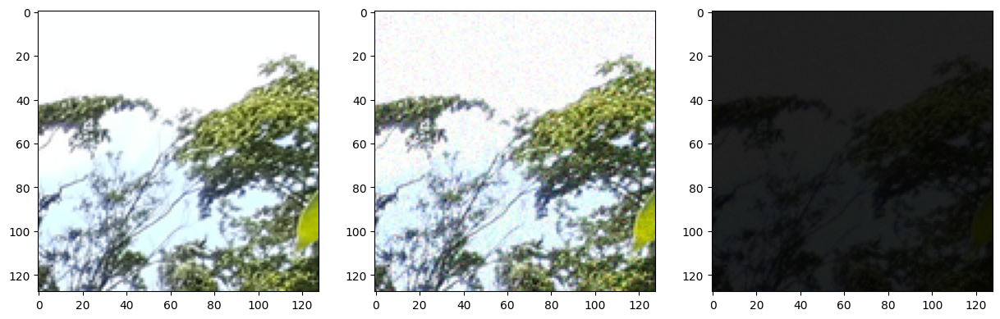

In [4]:
for patchs_noisy, patchs_true in data_train_batched:
    # with torch.autograd.set_detect_anomaly(True):
    with torch.no_grad():
        patchs_noisy = patchs_noisy.to(DEVICE)
        patchs_true = patchs_true.to(DEVICE)
        reconstruct_patchs = model(patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
    break


B = 2
img_true = np.clip(patchs_true[B].cpu().numpy(), a_min=0.0, a_max=100.0).astype(np.float64)
img_noisy = np.clip(patchs_noisy[B].cpu().numpy(), a_min=0.0, a_max=100.0).astype(np.float64)
img_recon = np.clip(reconstruct_patchs[B].cpu().numpy(), a_min=0.0, a_max=100.0).astype(np.float64)

fig, axs = plt.subplots( ncols=3, nrows=1, figsize=(15, 5))
axs[0].imshow(img_true)
axs[1].imshow(img_noisy)
axs[2].imshow(img_recon)
plt.show()

In [20]:
# CHECKPOINT_DIR = os.path.join(ROOT_PROJECT, "exploration/model_multiscale_mixture_GLR/result/model_GLT_GTV_deep/checkpoints/")
# training_state_path = os.path.join(CHECKPOINT_DIR, 'checkpoints_epoch00_iter0072k.pt')
# training_state = torch.load(training_state_path)
# model.load_state_dict(training_state["model"])

In [ ]:
i=0
for patchs_noisy, patchs_true in data_train_batched:
    # with torch.autograd.set_detect_anomaly(True):
    s = time.time()
    optimizer.zero_grad()
    patchs_noisy = patchs_noisy.to(DEVICE)
    patchs_true = patchs_true.to(DEVICE)
    reconstruct_patchs = model(patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
    loss_value = criterian(reconstruct_patchs, patchs_true)
    loss_value.backward()
    optimizer.step()

    img_true = np.clip(patchs_true.detach().cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
    img_recon = np.clip(reconstruct_patchs.detach().cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
    train_mse_value = np.square(img_true- img_recon).mean()
    train_psnr = 10 * np.log10(1/train_mse_value)
    print(f"iter={i} time={time.time()-s} psnr={train_psnr} mse={train_mse_value}")
    i+=1

    if i == 5000:
        break

iter=0 time=1.0751137733459473 psnr=7.613296383666325 mse=0.1732488504475428
iter=1 time=0.4247257709503174 psnr=8.242938692429737 mse=0.14986704036049184
iter=2 time=0.4213242530822754 psnr=6.6251380013021315 mse=0.21751349158906075
iter=3 time=0.42305684089660645 psnr=6.325077844131095 mse=0.23307313382420705
iter=4 time=0.4216947555541992 psnr=5.65207730272431 mse=0.2721399306176779
iter=5 time=0.42626357078552246 psnr=8.203263498549369 mse=0.15124243126201065
iter=6 time=0.4232349395751953 psnr=6.2416844492993375 mse=0.23759185869961885
iter=7 time=0.42228102684020996 psnr=7.39956392361756 mse=0.18198835844886596
iter=8 time=0.42226529121398926 psnr=7.290106031847285 mse=0.1866334124225184
iter=9 time=0.42748284339904785 psnr=7.310894372365674 mse=0.1857421904090639
iter=10 time=0.42284488677978516 psnr=8.471320209788512 mse=0.14218964797639158
iter=11 time=0.4233248233795166 psnr=7.244526771582388 mse=0.1886024468705149
iter=12 time=0.42398571968078613 psnr=6.882921677696043 mse=0

In [7]:
model.state_dict()

OrderedDict([('skip_connect_weight01',
              tensor([0.2324, 1.0330], device='cuda:0')),
             ('skip_connect_weight02',
              tensor([0.2574, 1.0586], device='cuda:0')),
             ('skip_connect_weight03',
              tensor([0.2712, 1.0901], device='cuda:0')),
             ('mixtureGLR_block01.alphaCGD',
              tensor([[ 0.3286,  0.5999,  0.5634,  0.5332],
                      [ 0.4147,  0.6899,  0.6447,  0.5674],
                      [-0.0768, -0.1914,  0.1506,  0.1411],
                      [-0.1380, -0.5731,  0.1785,  0.1801],
                      [ 1.0326,  1.0996,  0.8149,  0.8307],
                      [ 0.1542,  0.0307,  0.1263,  0.1276]], device='cuda:0')),
             ('mixtureGLR_block01.betaCGD',
              tensor([[0.1000, 0.1000, 0.1000, 0.1000],
                      [0.1202, 0.3645, 0.2763, 0.1877],
                      [0.1000, 0.1000, 0.1000, 0.1000],
                      [0.5867, 0.6598, 0.3706, 0.3843],
                

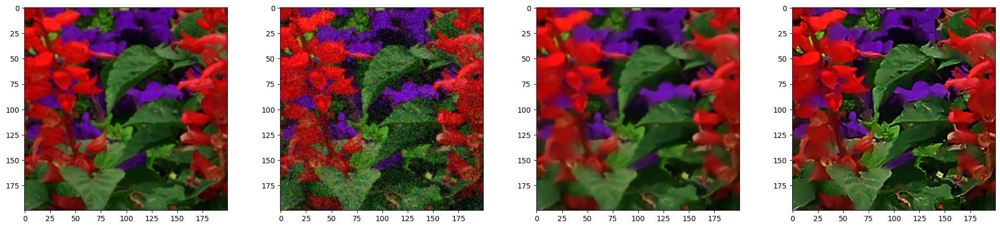

In [8]:
k = 0
###########
avg_kernel = 1.0 * torch.tensor([
    [0.0, -1.0, 0.0],
    [-1.0, 5.0, -1.0],
    [0.0, -1.0, 0.0],
])
kernel = []
for r in range(3):
    kernel.append(avg_kernel[np.newaxis, np.newaxis, :, :])

kernel = torch.concat(kernel, axis=0).to(DEVICE)


for patchs_noisy, patchs_true in data_test_batched:
    # with torch.autograd.set_detect_anomaly(True):
    if k == 2:
        with torch.no_grad():
            patchs_noisy = patchs_noisy.to(DEVICE)
            patchs_true = patchs_true.to(DEVICE)
            reconstruct_patchs = model(patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
            reconstruct_patchs_sharped = nn.functional.conv2d(
                reconstruct_patchs.permute(0, 3, 1, 2),
                weight=kernel,
                stride=1,
                padding=0,
                dilation=1,
                groups=3,
            ).permute(0, 2, 3, 1)
        break
    else:
        k+=1
        continue


B = 0
f,t = 200,400

img_true = np.clip(patchs_true[B].cpu().numpy()[f:t, f:t], a_min=0.0, a_max=100.0).astype(np.float64)
img_noisy = np.clip(patchs_noisy[B].cpu().numpy()[f:t, f:t], a_min=0.0, a_max=100.0).astype(np.float64)
img_recon = np.clip(reconstruct_patchs[B].cpu().numpy()[f:t, f:t], a_min=0.0, a_max=100.0).astype(np.float64)
img_recon2 = np.clip(reconstruct_patchs_sharped[B].cpu().numpy()[f:t, f:t], a_min=0.0, a_max=100.0).astype(np.float64)

fig, axs = plt.subplots( ncols=4, nrows=1, figsize=(24, 5))
axs[0].imshow(img_true)
axs[1].imshow(img_noisy)
axs[2].imshow(img_recon)
axs[3].imshow(img_recon2)
plt.show()

In [9]:
test_mse_value = np.square(img_true- img_recon).mean()
print(f"test_i={0} time={time.time()-s} test_i_psnr_value={10 * np.log10(1/test_mse_value)}")


test_i=0 time=65.35361075401306 test_i_psnr_value=27.426729189601623


In [ ]:
###########
avg_kernel = 1.0 * torch.tensor([
    [0.0, -1.0, 0.0],
    [-1.0, 5.0, -1.0],
    [0.0, -1.0, 0.0],
])
kernel = []
for r in range(3):
    kernel.append(avg_kernel[np.newaxis, np.newaxis, :, :])

kernel = torch.concat(kernel, axis=0).to(DEVICE)


In [10]:
# ### VALIDAING
model.eval()
list_test_mse = []
test_i = 0
for test_patchs_noisy, test_patchs_true in data_test_batched:
    s = time.time()
    with torch.no_grad():
        test_patchs_noisy = test_patchs_noisy.to(DEVICE)
        test_patchs_true = test_patchs_true.to(DEVICE) 
        reconstruct_patchs = model(test_patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
        img_true = np.clip(test_patchs_true[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_noisy = np.clip(test_patchs_noisy[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_recon = np.clip(reconstruct_patchs[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        test_mse_value = np.square(img_true- img_recon).mean()
        list_test_mse.append(test_mse_value)
        print(f"test_i={test_i} time={time.time()-s} test_i_psnr_value={10 * np.log10(1/test_mse_value)}")

        # fig, axs = plt.subplots( ncols=3, nrows=1, figsize=(15, 5))
        # axs[0].imshow(img_true)
        # axs[1].imshow(img_noisy)
        # axs[2].imshow(img_recon)
        # plt.show()
    test_i+=1

psnr_testing = 10 * np.log10(1/np.array(list_test_mse))
print(f"FINISH TESING EPOCH {0} - iter={0} -  psnr_testing={np.mean(psnr_testing)}")
# model.train()

test_i=0 time=0.20530414581298828 test_i_psnr_value=33.42531681490496
test_i=1 time=0.16700005531311035 test_i_psnr_value=35.47814706476402
test_i=2 time=0.16454005241394043 test_i_psnr_value=28.01800841477846
test_i=3 time=0.16511225700378418 test_i_psnr_value=33.59601242661873
test_i=4 time=0.16495704650878906 test_i_psnr_value=32.184893244131395
test_i=5 time=0.16511130332946777 test_i_psnr_value=30.255080357116185
test_i=6 time=0.16474032402038574 test_i_psnr_value=32.15020828760315
test_i=7 time=0.164947509765625 test_i_psnr_value=30.612442565975964
test_i=8 time=0.1649024486541748 test_i_psnr_value=27.21163575211836
test_i=9 time=0.16495752334594727 test_i_psnr_value=32.11567955925731
test_i=10 time=0.16441988945007324 test_i_psnr_value=32.58901787708102
test_i=11 time=0.16446590423583984 test_i_psnr_value=32.7295368080184
test_i=12 time=0.16446948051452637 test_i_psnr_value=29.459460631828946
test_i=13 time=0.16507863998413086 test_i_psnr_value=30.89732226128765
test_i=14 time=0

In [ ]:
# ### VALIDAING
model.eval()
list_test_mse = []
test_i = 0
for test_patchs_noisy, test_patchs_true in data_test_batched:
    s = time.time()
    with torch.no_grad():
        test_patchs_noisy = test_patchs_noisy.to(DEVICE)
        test_patchs_true = test_patchs_true.to(DEVICE) 
        reconstruct_patchs = model(test_patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
        img_true = np.clip(test_patchs_true[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_noisy = np.clip(test_patchs_noisy[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_recon = np.clip(reconstruct_patchs[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        test_mse_value = np.square(img_true- img_recon).mean()
        list_test_mse.append(test_mse_value)
        print(f"test_i={test_i} time={time.time()-s} test_i_psnr_value={10 * np.log10(1/test_mse_value)}")

        # fig, axs = plt.subplots( ncols=3, nrows=1, figsize=(15, 5))
        # axs[0].imshow(img_true)
        # axs[1].imshow(img_noisy)
        # axs[2].imshow(img_recon)
        # plt.show()
    test_i+=1

psnr_testing = 10 * np.log10(1/np.array(list_test_mse))
print(f"FINISH TESING EPOCH {0} - iter={0} -  psnr_testing={np.mean(psnr_testing)}")
# model.train()

test_i=0 time=0.40505075454711914 test_i_psnr_value=34.040999221163936
test_i=1 time=0.4062235355377197 test_i_psnr_value=36.36964301997965
test_i=2 time=0.4002962112426758 test_i_psnr_value=29.450763330700575
test_i=3 time=0.4066126346588135 test_i_psnr_value=33.96275419457065
test_i=4 time=0.40086841583251953 test_i_psnr_value=32.822542916858765
test_i=5 time=0.4053313732147217 test_i_psnr_value=30.762069966421812
test_i=6 time=0.39952969551086426 test_i_psnr_value=32.748066691474726
test_i=7 time=0.4045217037200928 test_i_psnr_value=31.134530096295677
test_i=8 time=0.40555882453918457 test_i_psnr_value=28.039281332724755
test_i=9 time=0.39667558670043945 test_i_psnr_value=32.83022367355358
test_i=10 time=0.4047727584838867 test_i_psnr_value=33.1332445836985
test_i=11 time=0.3961796760559082 test_i_psnr_value=33.117563762229324
test_i=12 time=0.403827428817749 test_i_psnr_value=29.892963203223534
test_i=13 time=0.39850449562072754 test_i_psnr_value=31.70135053131453
test_i=14 time=0.

In [ ]:
# ### VALIDAING
model.eval()
list_test_mse = []
test_i = 0
for test_patchs_noisy, test_patchs_true in data_test_batched:
    s = time.time()
    with torch.no_grad():
        test_patchs_noisy = test_patchs_noisy.to(DEVICE)
        test_patchs_true = test_patchs_true.to(DEVICE) 
        reconstruct_patchs = model(test_patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
        img_true = np.clip(test_patchs_true[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_noisy = np.clip(test_patchs_noisy[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_recon = np.clip(reconstruct_patchs[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        test_mse_value = np.square(img_true- img_recon).mean()
        list_test_mse.append(test_mse_value)
        print(f"test_i={test_i} time={time.time()-s} test_i_psnr_value={10 * np.log10(1/test_mse_value)}")

        # fig, axs = plt.subplots( ncols=3, nrows=1, figsize=(15, 5))
        # axs[0].imshow(img_true)
        # axs[1].imshow(img_noisy)
        # axs[2].imshow(img_recon)
        # plt.show()
    test_i+=1

psnr_testing = 10 * np.log10(1/np.array(list_test_mse))
print(f"FINISH TESING EPOCH {0} - iter={0} -  psnr_testing={np.mean(psnr_testing)}")
# model.train()

test_i=0 time=0.2925536632537842 test_i_psnr_value=32.562223083468346
test_i=1 time=0.26383519172668457 test_i_psnr_value=34.25509905327368
test_i=2 time=0.26436924934387207 test_i_psnr_value=28.148466707748202
test_i=3 time=0.26448988914489746 test_i_psnr_value=33.02486310815996
test_i=4 time=0.2637593746185303 test_i_psnr_value=31.739688979848133
test_i=5 time=0.26369333267211914 test_i_psnr_value=29.828298474664
test_i=6 time=0.26430606842041016 test_i_psnr_value=31.501721039690125
test_i=7 time=0.2640511989593506 test_i_psnr_value=30.189928141963197
test_i=8 time=0.2643718719482422 test_i_psnr_value=26.980377218015672
test_i=9 time=0.26421475410461426 test_i_psnr_value=31.23969692845822
test_i=10 time=0.26350998878479004 test_i_psnr_value=31.727130462649068
test_i=11 time=0.2635211944580078 test_i_psnr_value=32.22350491327327
test_i=12 time=0.2635972499847412 test_i_psnr_value=28.843079011329085
test_i=13 time=0.2636418342590332 test_i_psnr_value=30.72465817496105
test_i=14 time=0.

In [ ]:
# ### VALIDAING
model.eval()
list_test_mse = []
test_i = 0
for test_patchs_noisy, test_patchs_true in data_test_batched:
    s = time.time()
    with torch.no_grad():
        test_patchs_noisy = test_patchs_noisy.to(DEVICE)
        test_patchs_true = test_patchs_true.to(DEVICE) 
        reconstruct_patchs = model(test_patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
        img_true = np.clip(test_patchs_true[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_noisy = np.clip(test_patchs_noisy[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_recon = np.clip(reconstruct_patchs[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        test_mse_value = np.square(img_true- img_recon).mean()
        list_test_mse.append(test_mse_value)
        print(f"test_i={test_i} time={time.time()-s} test_i_psnr_value={10 * np.log10(1/test_mse_value)}")

        # fig, axs = plt.subplots( ncols=3, nrows=1, figsize=(15, 5))
        # axs[0].imshow(img_true)
        # axs[1].imshow(img_noisy)
        # axs[2].imshow(img_recon)
        # plt.show()
    test_i+=1

psnr_testing = 10 * np.log10(1/np.array(list_test_mse))
print(f"FINISH TESING EPOCH {0} - iter={0} -  psnr_testing={np.mean(psnr_testing)}")
# model.train()

test_i=0 time=0.3531491756439209 test_i_psnr_value=33.14351488058646
test_i=1 time=0.32968592643737793 test_i_psnr_value=35.05421823607449
test_i=2 time=0.33566737174987793 test_i_psnr_value=29.425334207166046
test_i=3 time=0.33112263679504395 test_i_psnr_value=33.442352162342125
test_i=4 time=0.33524155616760254 test_i_psnr_value=32.36562491185825
test_i=5 time=0.33101797103881836 test_i_psnr_value=30.288240270265735
test_i=6 time=0.33699560165405273 test_i_psnr_value=32.19618203643218
test_i=7 time=0.33115506172180176 test_i_psnr_value=30.68785495214646
test_i=8 time=0.32999324798583984 test_i_psnr_value=27.88922401920919
test_i=9 time=0.33531808853149414 test_i_psnr_value=31.89611050584268
test_i=10 time=0.3318521976470947 test_i_psnr_value=32.57564455986514
test_i=11 time=0.33520984649658203 test_i_psnr_value=32.74793567084842
test_i=12 time=0.33293747901916504 test_i_psnr_value=29.42364847503667
test_i=13 time=0.3358135223388672 test_i_psnr_value=31.444991484134004
test_i=14 time=

# 07

In [1]:
import os, sys 
import itertools
import collections
import random
import time 
import logging

from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
from matplotlib.pyplot import imread

import torch
import torch.nn as nn
from torch.utils.data import Dataset
from torchvision.transforms import ToTensor
from torch.optim import Adam, AdamW
from torch.optim.lr_scheduler import MultiStepLR
from torch.profiler import profile, record_function, ProfilerActivity

#########################################################################################################
torch.set_float32_matmul_precision('high')
DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
ROOT_PROJECT = "/home/dotamthuc/Works/Projects/ImageRestoration-Development-Unrolling/"
ROOT_DATASET = "/home/dotamthuc/Works/Projects/ImageRestoration-Development-Unrolling"

#########################################################################################################

sys.path.append(os.path.join(ROOT_PROJECT, 'exploration/model_multiscale_mixture_GLR/lib'))
from dataloader import ImageSuperResolution

LOG_DIR = os.path.join(ROOT_PROJECT, "exploration/model_multiscale_mixture_GLR/result/model_MMGLR_deep/logs/")
LOGGER = logging.getLogger("main")
logging.basicConfig(
    format='%(asctime)s: %(message)s', 
    datefmt='%m/%d/%Y %I:%M:%S %p',
    filename=os.path.join(LOG_DIR, 'training00.log'), 
    level=logging.INFO
)

CHECKPOINT_DIR = os.path.join(ROOT_PROJECT, "exploration/model_multiscale_mixture_GLR/result/model_MMGLR_deep/checkpoints/")
VERBOSE_RATE = 1000

(H_train, W_train) = (128, 128)
(H_val, W_val) = (128, 128)
(H_test, W_test) = (496, 496)

train_dataset = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/DFWB_training_data_info.csv"),
    dist_mode="vary_addictive_noise",
    lambda_noise=[[1.0, 10.0, 15.0, 20.0, 25.0], [0.1, 0.1, 0.1, 0.1, 0.6]],
    patch_size=(H_train, W_train),
    patch_overlap_size=(H_train//2, W_train//2),
    max_num_patchs=1000000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)

validation_dataset = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/CBSD68_testing_data_info.csv"),
    dist_mode="addictive_noise",
    lambda_noise=25.0,
    patch_size=(H_val, H_val),
    patch_overlap_size=(H_val//2, H_val//2),
    max_num_patchs=1000000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)

test_dataset = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/McMaster_testing_data_info.csv"),
    dist_mode="addictive_noise",
    lambda_noise=25.0,
    patch_size=(H_test, W_test),
    patch_overlap_size=(0, 0),
    max_num_patchs=1000000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)


data_train_batched = torch.utils.data.DataLoader(
    train_dataset, batch_size=4, num_workers=4
)

data_valid_batched = torch.utils.data.DataLoader(
    validation_dataset, batch_size=16, num_workers=4
)

data_test_batched = torch.utils.data.DataLoader(
    test_dataset, batch_size=1, num_workers=4
)

In [ ]:
import itertools
import collections
import numpy as np
import torch
import torch.nn as nn
from torch.nn.parameter import Parameter
from torch.profiler import profile, record_function, ProfilerActivity
# torch.set_default_dtype(torch.float64)

from einops import rearrange


class CustomLayerNorm(nn.Module):
    def __init__(self, nchannels):
        super(CustomLayerNorm, self).__init__()
        
        self.nchannels = nchannels
        self.weighted_transform = nn.Conv2d(nchannels, nchannels, kernel_size=1, stride=1, groups=nchannels, bias=False)

    def forward(self, x):
        # bz, nchannels, h, w = x.shape
        sigma = x.var(dim=1, keepdim=True, correction=1)
        # bz, 1, h, w = sigma.shape
        return self.weighted_transform(x / torch.sqrt(sigma+1e-5))
    


##########################################################################
class FeedForward(nn.Module):
    def __init__(self, dim, ffn_expansion_factor, bias):
        super(FeedForward, self).__init__()

        hidden_features = int(dim*ffn_expansion_factor)
        # hidden_features = dim

        self.project_in = nn.Conv2d(dim, hidden_features*2, kernel_size=1, bias=bias)

        self.dwconv = nn.Conv2d(hidden_features*2, hidden_features*2, kernel_size=3, stride=1, padding=1, groups=hidden_features*2, bias=bias)

        self.project_out = nn.Conv2d(hidden_features, dim, kernel_size=1, bias=bias)

    def forward(self, x):
        x = self.project_in(x)
        x1, x2 = self.dwconv(x).chunk(2, dim=1)
        x = nn.functional.gelu(x1) * x2
        x = self.project_out(x)
        return x


##########################################################################
class FFBlock(nn.Module):
    def __init__(self, dim, ffn_expansion_factor, bias):
        super(FFBlock, self).__init__()

        self.norm = CustomLayerNorm(dim)

        self.skip_connect_weight_final = Parameter(
            torch.ones((2), dtype=torch.float32) * torch.tensor([0.5, 0.5]),
            requires_grad=True
        )
        self.ffn = FeedForward(dim, ffn_expansion_factor, bias)

    def forward(self, x):
        # x = self.skip_connect_weight_final[0]*x + self.skip_connect_weight_final[1]*self.ffn(self.norm(x))
        x = x + self.ffn(self.norm(x))

        return x



##########################################################################
## Overlapped image patch embedding with 3x3 Conv
class OverlapPatchEmbed(nn.Module):
    def __init__(self, in_c=3, embed_dim=48, bias=False):
        super(OverlapPatchEmbed, self).__init__()

        self.proj = nn.Conv2d(in_c, embed_dim, kernel_size=3, stride=1, padding=1, bias=bias)

    def forward(self, x):
        x = self.proj(x)

        return x



##########################################################################
## Resizing modules
class Downsample(nn.Module):
    def __init__(self, n_feat):
        super(Downsample, self).__init__()

        self.body = nn.Sequential(nn.Conv2d(n_feat, n_feat//2, kernel_size=3, stride=1, padding=1, bias=False),
                                  nn.PixelUnshuffle(2))

    def forward(self, x):
        return self.body(x)

class Upsample(nn.Module):
    def __init__(self, n_feat):
        super(Upsample, self).__init__()

        self.body = nn.Sequential(nn.Conv2d(n_feat, n_feat*2, kernel_size=3, stride=1, padding=1, bias=False),
                                  nn.PixelShuffle(2))

    def forward(self, x):
        return self.body(x)

##########################################################################
class FeatureExtraction(nn.Module):
    def __init__(self, 
        inp_channels=3, 
        out_channels=48, 
        dim = 48,
        num_blocks = [1,2,2,4], 
        num_refinement_blocks = 4,
        ffn_expansion_factor = 2.66,
        bias = False,
    ):

        super(FeatureExtraction, self).__init__()

        self.patch_embed = OverlapPatchEmbed(inp_channels, dim)

        self.encoder_level1 = nn.Sequential(*[FFBlock(dim=dim, ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[0])])
        
        self.down1_2 = Downsample(dim) ## From Level 1 to Level 2
        self.encoder_level2 = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[1])])
        
        self.down2_3 = Downsample(int(dim*2**1)) ## From Level 2 to Level 3
        self.encoder_level3 = nn.Sequential(*[FFBlock(dim=int(dim*2**2), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[2])])

        self.down3_4 = Downsample(int(dim*2**2)) ## From Level 3 to Level 4
        self.latent = nn.Sequential(*[FFBlock(dim=int(dim*2**3), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[3])])
        
        self.up4_3 = Upsample(int(dim*2**3)) ## From Level 4 to Level 3
        self.reduce_chan_level3 = nn.Conv2d(int(dim*2**3), int(dim*2**2), kernel_size=1, bias=bias)
        self.decoder_level3 = nn.Sequential(*[FFBlock(dim=int(dim*2**2), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[2])])


        self.up3_2 = Upsample(int(dim*2**2)) ## From Level 3 to Level 2
        self.reduce_chan_level2 = nn.Conv2d(int(dim*2**2), int(dim*2**1), kernel_size=1, bias=bias)
        self.decoder_level2 = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[1])])
        
        self.up2_1 = Upsample(int(dim*2**1))  ## From Level 2 to Level 1  (NO 1x1 conv to reduce channels)

        self.decoder_level1 = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[0])])
        
        self.refinement = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_refinement_blocks)])

        ###########################
        self.output = nn.Conv2d(int(dim*2**1), out_channels, kernel_size=3, stride=1, padding=1, bias=bias)

    def forward(self, inp_img):

        inp_enc_level1 = self.patch_embed(inp_img)
        out_enc_level1 = self.encoder_level1(inp_enc_level1)
        
        inp_enc_level2 = self.down1_2(out_enc_level1)
        out_enc_level2 = self.encoder_level2(inp_enc_level2)

        inp_enc_level3 = self.down2_3(out_enc_level2)
        out_enc_level3 = self.encoder_level3(inp_enc_level3) 

        inp_enc_level4 = self.down3_4(out_enc_level3)        
        latent = self.latent(inp_enc_level4) 
                        
        inp_dec_level3 = self.up4_3(latent)
        inp_dec_level3 = torch.cat([inp_dec_level3, out_enc_level3], 1)
        inp_dec_level3 = self.reduce_chan_level3(inp_dec_level3)
        out_dec_level3 = self.decoder_level3(inp_dec_level3) 

        inp_dec_level2 = self.up3_2(out_dec_level3)
        inp_dec_level2 = torch.cat([inp_dec_level2, out_enc_level2], 1)
        inp_dec_level2 = self.reduce_chan_level2(inp_dec_level2)
        out_dec_level2 = self.decoder_level2(inp_dec_level2) 

        inp_dec_level1 = self.up2_1(out_dec_level2)
        inp_dec_level1 = torch.cat([inp_dec_level1, out_enc_level1], 1)
        out_dec_level1 = self.decoder_level1(inp_dec_level1)
        
        out_dec_level1 = self.refinement(out_dec_level1)
        out_dec_level1 = self.output(out_dec_level1)

        # return [latent, out_dec_level3, out_dec_level2, out_dec_level1]
        return [out_dec_level1, out_dec_level2, out_dec_level3, latent]


class GLRFast(nn.Module):
    def __init__(self, 
            n_channels, n_node_fts, n_graphs, connection_window, device, M_diag_init=0.4
        ):
        super(GLRFast, self).__init__()

        self.device = device
        self.n_channels        = n_channels
        self.n_node_fts        = n_node_fts
        self.n_graphs          = n_graphs
        self.n_edges           = (connection_window == 1).sum()
        self.connection_window = connection_window
        self.buffer_size       = connection_window.sum()

        # edges type from connection_window
        window_size = connection_window.shape[0]
        connection_window = connection_window.reshape((-1))
        m = np.arange(window_size)-window_size//2
        edge_delta = np.array(
            list(itertools.product(m, m)),
            dtype=np.int32
        )
        self.edge_delta = edge_delta[connection_window == 1]
        
        self.pad_dim_hw = np.abs(self.edge_delta.min(axis=0))


        ### Trainable parameters
        # features on nodes #self.n_node_fts
        self.multiM = Parameter(
            torch.ones((self.n_graphs, self.n_node_fts), device=self.device, dtype=torch.float32)*M_diag_init,
            requires_grad=True,
        )


    def get_neighbors_pixels(self, img_features):
        _, _, H, W = img_features.shape
        padH, padW = self.pad_dim_hw
        img_features_frame = nn.functional.pad(img_features, (padW, padW, padH, padH), "replicate")
        neighbors_pixels = []
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            neighbors_pixels.append(
                img_features_frame[:, :, fromh:toh, fromw:tow]
            )
        neighbors_pixels_features = torch.stack(neighbors_pixels, axis=-3)

        return neighbors_pixels_features
    

    def normalize_and_transform_features(self, img_features):
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape
        # img_features = img_features.view(batch_size, self.n_graphs, self.n_node_fts, h_size, w_size)
        img_features = torch.nn.functional.normalize(img_features, dim=2)

        img_features_transform = torch.einsum(
            "bhcHW, hc -> bhcHW", img_features, self.multiM
        )
    
        img_features_transform = img_features_transform.view(batch_size, self.n_graphs*self.n_node_fts, h_size, w_size)

        return img_features_transform


    def extract_edge_weights(self, img_features):
        
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape

        img_features = self.normalize_and_transform_features(img_features)
        img_features_neighbors = self.get_neighbors_pixels(img_features)

        features_similarity = (img_features[:, :, None, :, :] * img_features_neighbors)
        features_similarity = features_similarity.view(
            batch_size, self.n_graphs, self.n_node_fts, self.n_edges, h_size, w_size
        ).sum(axis=2)

        edge_weights_norm = nn.functional.softmax(features_similarity, dim=2) 
        node_degree = edge_weights_norm.sum(axis=2)

        return edge_weights_norm, node_degree
    


    def op_L_norm(self, img_signals, edge_weights, node_degree):

        batch_size, n_graphs, n_channels, h_size, w_size = img_signals.shape
        img_features_neighbors = self.get_neighbors_pixels(
            img_signals.view(batch_size, n_graphs*n_channels, h_size, w_size)
        ).view(batch_size, n_graphs, n_channels, self.n_edges, h_size, w_size)
        Wx = torch.einsum(
            "bhceHW, bheHW -> bhcHW", img_features_neighbors, edge_weights
        )
        output = img_signals - Wx
        return output

    def forward(self, patchs, edge_weights, node_degree):
        output_patchs = self.op_L_norm(patchs, edge_weights, node_degree)
        return output_patchs
    



class GTVFast(nn.Module):
    def __init__(self, 
            n_channels, n_node_fts, n_graphs, connection_window, device, M_diag_init=0.4
        ):
        super(GTVFast, self).__init__()

        self.device = device
        self.n_channels        = n_channels
        self.n_node_fts        = n_node_fts
        self.n_graphs          = n_graphs
        self.n_edges           = (connection_window == 1).sum()
        self.connection_window = connection_window
        self.buffer_size       = connection_window.sum()

        # edges type from connection_window
        window_size = connection_window.shape[0]
        connection_window = connection_window.reshape((-1))
        m = np.arange(window_size)-window_size//2
        edge_delta = np.array(
            list(itertools.product(m, m)),
            dtype=np.int32
        )
        self.edge_delta = edge_delta[connection_window == 1]
        
        self.pad_dim_hw = np.abs(self.edge_delta.min(axis=0))


        ### Trainable parameters
        # features on nodes #self.n_node_fts
        self.multiM = Parameter(
            torch.ones((self.n_graphs, self.n_node_fts), device=self.device, dtype=torch.float32)*M_diag_init,
            requires_grad=True,
        )
        ############
        # avg_kernel = 1.0 * torch.tensor([
        #     [0.0, 0.0, 0.0],
        #     [0.0, 1.0, 0.0],
        #     [0.0, 0.0, 0.0],
        # ])
        # kernel = []
        # for r in range(self.n_channels):
        #     kernel.append(avg_kernel[np.newaxis, np.newaxis, :, :])

        # kernel = torch.concat(kernel, axis=0).to(self.device)
        # self.stats_kernel = Parameter(
        #     torch.ones((self.n_channels, 1, 3, 3), device=self.device, dtype=torch.float32) * kernel,
        #     requires_grad=True,
        # )

    def get_neighbors_pixels(self, img_features):
        _, _, H, W = img_features.shape
        padH, padW = self.pad_dim_hw
        img_features_frame = nn.functional.pad(img_features, (padW, padW, padH, padH), "replicate")
        neighbors_pixels = []
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            neighbors_pixels.append(
                img_features_frame[:, :, fromh:toh, fromw:tow]
            )
        neighbors_pixels_features = torch.stack(neighbors_pixels, axis=-3)

        return neighbors_pixels_features
    

    def normalize_and_transform_features(self, img_features):
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape
        # img_features = img_features.view(batch_size, self.n_graphs, self.n_node_fts, h_size, w_size)
        img_features = torch.nn.functional.normalize(img_features, dim=2)

        img_features_transform = torch.einsum(
            "bhcHW, hc -> bhcHW", img_features, self.multiM
        )
    
        img_features_transform = img_features_transform.view(batch_size, self.n_graphs*self.n_node_fts, h_size, w_size)

        return img_features_transform


    def extract_edge_weights(self, img_features):
        
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape

        img_features = self.normalize_and_transform_features(img_features)
        img_features_neighbors = self.get_neighbors_pixels(img_features)

        features_similarity = (img_features[:, :, None, :, :] * img_features_neighbors)
        features_similarity = features_similarity.view(
            batch_size, self.n_graphs, self.n_node_fts, self.n_edges, h_size, w_size
        ).sum(axis=2)

        edge_weights_norm = nn.functional.softmax(features_similarity, dim=2) 
        node_degree = edge_weights_norm.sum(axis=2)

        return edge_weights_norm, node_degree
    
    # def stats_conv(self, patchs):
    #     batch_size, n_graphs, c_size, h_size, w_size = patchs.shape
    #     temp_patch = patchs.view(batch_size*n_graphs, c_size, h_size, w_size)
    #     temp_patch = nn.functional.pad(temp_patch, (1,1,1,1), 'reflect')
    #     temp_out_patch = nn.functional.conv2d(
    #         temp_patch,
    #         weight=self.stats_kernel,
    #         stride=1,
    #         padding=0,
    #         dilation=1,
    #         groups=self.n_channels,
    #     )
    #     out_patch = temp_out_patch.view(batch_size, n_graphs, c_size, h_size, w_size)
    #     return out_patch

    # def stats_conv_transpose(self, patchs):
    #     batch_size, n_graphs, c_size, h_size, w_size = patchs.shape
    #     temp_patch = patchs.reshape(batch_size*n_graphs, c_size, h_size, w_size)
    #     temp_out_patch = nn.functional.conv_transpose2d(
    #         temp_patch,
    #         weight=self.stats_kernel,
    #         stride=1,
    #         padding=1,
    #         dilation=1,
    #         groups=self.n_channels,
    #     )
    #     out_patch = temp_out_patch.view(batch_size, n_graphs, c_size, h_size, h_size)
    #     return out_patch

    def op_C(self, img_signals, edge_weights, node_degree):


        batch_size, n_graphs, n_channels, h_size, w_size = img_signals.shape
        # img_signals = self.stats_conv(img_signals)

        img_features_neighbors = self.get_neighbors_pixels(
            img_signals.view(batch_size, n_graphs*n_channels, h_size, w_size)
        ).view(batch_size, n_graphs, n_channels, self.n_edges, h_size, w_size)
        Cx1 = img_signals[:, :, :, None, :, :] * edge_weights[:, :, None, :, :, :]
        Cx2 = img_features_neighbors * edge_weights[:, :, None, :, :, :]
        
        output = Cx1 - Cx2

        return output
    
    def op_C_transpose(self, edge_signals, edge_weights, node_degree):

        batch_size, n_graphs, n_channels, n_edges, H, W = edge_signals.shape
        edge_signals = edge_signals * edge_weights[:, :, None, :, :, :]

        output = edge_signals.sum(axis=3)

        padH, padW = self.pad_dim_hw
        output = nn.functional.pad(
            output.view(batch_size, n_graphs*n_channels, H, W),
            (padW, padW, padH, padH), "replicate"
        ).view(batch_size, n_graphs, n_channels, H + 2*padH, W + 2*padW)

        i=0
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            output[:, :, :, fromh:toh, fromw:tow] = output[:, :, :, fromh:toh, fromw:tow] - edge_signals[:, :, :, i, :, :]
            i+=1

        output = output[:, :, :, padH:-padH, padW:-padW]

        # output = self.stats_conv_transpose(output)
        return output

    def forward(self, patchs, edge_weights, node_degree):
        # C^T C
        edges_signals = self.op_C(patchs, edge_weights, node_degree)
        output_patchs = self.op_C_transpose(edges_signals, edge_weights, node_degree)

        return output_patchs
    

#########################################################################
# class DCextractor(nn.Module):
#     def __init__(self, n_channels):
#         super(DCextractor, self).__init__()
#             ############
#         self.n_channels = n_channels

#         avg_kernel = (1.0/25.0) * torch.tensor([
#             [1.0, 1.0, 1.0, 1.0, 1.0],
#             [1.0, 1.0, 1.0, 1.0, 1.0],
#             [1.0, 1.0, 1.0, 1.0, 1.0],
#             [1.0, 1.0, 1.0, 1.0, 1.0],
#             [1.0, 1.0, 1.0, 1.0, 1.0],
#         ])
#         kernel = []
#         for r in range(self.n_channels):
#             kernel.append(avg_kernel[np.newaxis, np.newaxis, :, :])

#         kernel = torch.concat(kernel, axis=0)
#         self.avg_kernel = Parameter(
#             torch.ones((self.n_channels, 1, 5, 5), dtype=torch.float32) * kernel,
#             requires_grad=True,
#         )

#     def forward(self, patchs):

#         patchs_padded = nn.functional.pad(patchs, (2, 2, 2, 2), "replicate")
#         patch_local_avg = nn.functional.conv2d(
#             patchs_padded, 
#             self.avg_kernel, 
#             bias=None, 
#             stride=1, 
#             padding=0, 
#             dilation=1,
#             groups=self.n_channels,
#         ) 
#         return patch_local_avg


#########################################################################
class DCextractor(nn.Module):
    def __init__(self, dim_in, dim_out, hidden_features):
        super(DCextractor, self).__init__()

        self.project_in = nn.Conv2d(dim_in, hidden_features*2, kernel_size=1, bias=False)
        self.dwconv = nn.Conv2d(hidden_features*2, hidden_features*2, kernel_size=3, stride=1, padding=1, groups=hidden_features*2, bias=False)
        self.project_out = nn.Conv2d(hidden_features, dim_out, kernel_size=1, bias=False)
        # self.skip_connect_weight = Parameter(
        #     torch.ones((2), dtype=torch.float32) * torch.tensor([0.5, 0.5]),
        #     requires_grad=True
        # )
        
    def forward(self, patchs):

        out = self.project_in(patchs)
        out01, out02 = self.dwconv(out).chunk(2, dim=1)
        out = nn.functional.gelu(out01) * out02
        out = self.project_out(out)
        # out = self.skip_connect_weight[0] * patchs + self.skip_connect_weight[1] * out\
        return out


class MixtureGTV(nn.Module):
    def __init__(self, 
            nchannels_in,
            n_graphs,
            n_node_fts,
            connection_window,
            n_cgd_iters,
            alpha_init,
            beta_init,
            muy_init, ro_init, gamma_init,
            device
        ):
        super(MixtureGTV, self).__init__()

        self.device       = device
        self.n_graphs     = n_graphs
        self.n_node_fts   = n_node_fts
        self.n_total_fts  = n_graphs * n_node_fts
        self.n_levels     = 4
        self.n_cgd_iters  = n_cgd_iters
        self.nchannels_in = nchannels_in
        self.connection_window = connection_window

        self.alphaCGD =  Parameter(
            torch.ones((self.n_cgd_iters, n_graphs), device=self.device, dtype=torch.float32) * alpha_init,
            requires_grad=True
        )

        self.betaCGD =  Parameter(
            torch.ones((self.n_cgd_iters, n_graphs), device=self.device, dtype=torch.float32) * beta_init,
            requires_grad=True
        )

        self.patchs_features_extraction = FeatureExtraction(
            inp_channels=3, 
            out_channels=self.n_total_fts, 
            dim = self.n_total_fts,
            num_blocks = [2, 3, 3, 4], 
            num_refinement_blocks = 4,
            ffn_expansion_factor = 1,
            bias = False,
        ).to(self.device)
        
        self.local_dc_extraction = DCextractor(self.n_total_fts, self.nchannels_in, self.n_total_fts).to(self.device)


        self.combination_weight = nn.Sequential(
            nn.Conv2d(
                in_channels=self.n_total_fts, 
                out_channels=self.n_graphs, 
                kernel_size=1,
                stride=1,
                padding=0,
                padding_mode="zeros",
                bias=False
            ),
            nn.Softmax(dim=1)
        ).to(self.device)

        self.ro00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * ro_init[0],
            requires_grad=True,
        )
        self.gamma00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * torch.log(gamma_init[0]),
            requires_grad=True,
        )
        self.GTVmodule00 = GTVFast(
            n_channels=self.nchannels_in,
            n_node_fts=self.n_node_fts,
            n_graphs=self.n_graphs,
            connection_window=self.connection_window,
            device=self.device,
            M_diag_init=1.0
        )

        self.muys00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * muy_init[0],
            requires_grad=True,
        )
        self.GLRmodule00 = GLRFast(
            n_channels=self.nchannels_in,
            n_node_fts=self.n_node_fts,
            n_graphs=self.n_graphs,
            connection_window=self.connection_window,
            device=self.device,
            M_diag_init=1.0
        )

    def apply_lightweight_transformer(self, patchs, list_graph_weightGTV, list_graph_weightGLR):

        batch_size, n_graphs, c_size, h_size, w_size = patchs.shape 
        patchs = patchs.contiguous()
        graph_weights, graph_degree = list_graph_weightGLR[0]

        Lpatchs = self.GLRmodule00(patchs, graph_weights, graph_degree)
        Lpatchs = torch.einsum(
            "bHchw, H -> bHchw", Lpatchs, self.muys00
        )

        graph_weights, graph_degree = list_graph_weightGTV[0]
        CtCpatchs = self.GTVmodule00(patchs, graph_weights, graph_degree)
        CtCpatchs = torch.einsum(
            "bHchw, H -> bHchw", CtCpatchs, self.ro00
        )

        output = patchs + Lpatchs + CtCpatchs

        return output
    
    def soft_threshold(self, delta, gamma):
        # batch_size, n_graphs, n_channels, n_edges, H, W = delta.shape
        # n_graphs = gamma.shape

        gamma = gamma[None, :, None, None, None, None]
        # print(f"Gamma.shape={gamma.shape}")

        condA = (delta < -gamma) 
        outputA = torch.where(
            condA,
            delta+gamma,
            0.0
        )
        condB = (delta > gamma) 
        outputB = torch.where(
            condB,
            delta-gamma,
            0.0
        )
        output = outputA + outputB
        return output


    def forward(self, patchs):
        # with record_function("MultiScaleMixtureGLR:forward"): 
        # print("#"*80)
        # patchs = patchs.permute(dims=(0, 3, 1, 2))
        # patchs = patchs.contiguous()
        # patchs = self.images_domain_to_abtract_domain(patchs)
        # print(f"patchs.shape={patchs.shape}")
        batch_size, c_size, h_size, w_size = patchs.shape
        #####
        ## Graph low pass filter
        list_features_patchs = self.patchs_features_extraction(patchs)
        list_graph_weightGTV = [None] * self.n_levels
        list_graph_weightGLR = [None] * self.n_levels
        bz, nfts, h, w = list_features_patchs[0].shape

        list_graph_weightGTV[0] = self.GTVmodule00.extract_edge_weights(
            list_features_patchs[0].view((bz, self.GTVmodule00.n_graphs, self.GTVmodule00.n_node_fts, h, w))
        )
        list_graph_weightGLR[0] = self.GLRmodule00.extract_edge_weights(
            list_features_patchs[0].view((bz, self.GLRmodule00.n_graphs, self.GLRmodule00.n_node_fts, h, w))
        )

        ############################################################
        local_avg = self.local_dc_extraction(list_features_patchs[0])
        y_tilde = patchs - local_avg

        ############################################################
        epsilon = self.GTVmodule00.op_C(y_tilde[:, None, :, :, :], list_graph_weightGTV[0][0], list_graph_weightGTV[0][1])
        bias    = torch.zeros_like(epsilon)

        left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
        left_hand_size *= self.ro00[None, :, None, None, None]
        left_hand_size += y_tilde[:, None, :, :, :]
        ############################################################
        output = left_hand_size
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual
        output = output + self.alphaCGD[0, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[1, None, :, None, None, None] * update
        output = output + self.alphaCGD[1, None, :, None, None, None] * update

        epsilon = self.soft_threshold(
            self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) + bias,
            torch.exp(self.gamma00)
        )
        bias  = bias + (self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) - epsilon)

        left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
        left_hand_size *= self.ro00[None, :, None, None, None]
        left_hand_size += y_tilde[:, None, :, :, :]
        ############################################################

        output = left_hand_size
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual
        output = output + self.alphaCGD[2, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[3, None, :, None, None, None] * update
        output = output + self.alphaCGD[3, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[4, None, :, None, None, None] * update
        output = output + self.alphaCGD[4, None, :, None, None, None] * update
        
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[5, None, :, None, None, None] * update
        output = output + self.alphaCGD[5, None, :, None, None, None] * update
        

        score = self.combination_weight(list_features_patchs[0])
        output = torch.einsum(
            "bgchw, bghw -> bchw", output, score
        )

        output = output + local_avg

        return output

    
#########################################################################
class SharpeningBlock(nn.Module):
    def __init__(self, dim_in, dim_out, hidden_features):
        super(SharpeningBlock, self).__init__()

        self.project_in = nn.Conv2d(dim_in, hidden_features*2, kernel_size=1, bias=False)
        self.dwconv = nn.Conv2d(hidden_features*2, hidden_features*2, kernel_size=3, stride=1, padding=1, groups=hidden_features*2, bias=False)
        self.project_out = nn.Conv2d(hidden_features, dim_out, kernel_size=1, bias=False)
        self.skip_connect_weight = Parameter(
            torch.ones((2), dtype=torch.float32) * torch.tensor([0.5, 0.5]),
            requires_grad=True
        )
        
    def forward(self, patchs):

        out = self.project_in(patchs)
        out01, out02 = self.dwconv(out).chunk(2, dim=1)
        out = nn.functional.gelu(out01) * out02
        out = self.project_out(out)
        out = self.skip_connect_weight[0] * patchs + self.skip_connect_weight[1] * out
        return out


class MultiScaleSequenceDenoiser(nn.Module):
    def __init__(self, device):
        super(MultiScaleSequenceDenoiser, self).__init__()
        self.device = device

        CONNECTION_FLAGS_3x3= np.array([
            1,1,1,
            1,0,1,
            1,1,1,
        ]).reshape((3,3))

        CONNECTION_FLAGS_5x5 = np.array([
            1,1,1,1,1,
            1,1,1,1,1,
            1,1,0,1,1,
            1,1,1,1,1,
            1,1,1,1,1,
        ]).reshape((5,5))

        # self.skip_connect_weight01 = Parameter(
        #     torch.ones((2), dtype=torch.float32, device=device) * torch.tensor([0.1, 0.9]).to(device),
        #     requires_grad=True
        # )
        # self.mixtureGLR_block01 = MixtureGTV(
        #     nchannels_in=3,
        #     n_graphs=4,
        #     n_node_fts=6,
        #     connection_window=CONNECTION_FLAGS_3x3,
        #     n_cgd_iters=6,
        #     alpha_init=0.5,
        #     beta_init=0.1,
        #     muy_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
        #     ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
        #     gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(self.device),
        #     device=self.device
        # )
        # self.sharp01 = SharpeningBlock(3, 3, 24).to(device)
        

        # self.skip_connect_weight02 = Parameter(
        #     torch.ones((2), dtype=torch.float32, device=device) * torch.tensor([0.1, 0.9]).to(device),
        #     requires_grad=True
        # )
        # self.mixtureGLR_block02 = MixtureGTV(
        #     nchannels_in=3,
        #     n_graphs=4,
        #     n_node_fts=6,
        #     connection_window=CONNECTION_FLAGS_3x3,
        #     n_cgd_iters=6,
        #     alpha_init=0.5,
        #     beta_init=0.1,
        #     muy_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
        #     ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
        #     gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(self.device),
        #     device=self.device
        # )
        # self.sharp02 = SharpeningBlock(3, 3, 24).to(device)
        

        # self.skip_connect_weight03 = Parameter(
        #     torch.ones((2), dtype=torch.float32, device=self.device) * torch.tensor([0.1, 0.9]).to(device),
        #     requires_grad=True
        # )
        # self.mixtureGLR_block03 = MixtureGTV(
        #     nchannels_in=3,
        #     n_graphs=4,
        #     n_node_fts=12,
        #     connection_window=CONNECTION_FLAGS_5x5,
        #     n_cgd_iters=6,
        #     alpha_init=0.5,
        #     beta_init=0.1,
        #     muy_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
        #     ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
        #     gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(self.device),
        #     device=self.device
        # )
        # self.sharp03 = SharpeningBlock(3, 3, 24).to(device)
        self.nullresformer = FeatureExtraction(
            inp_channels=3, 
            out_channels=3, 
            dim = 48,
            num_blocks = [4, 6, 6, 8], 
            num_refinement_blocks = 4,
            ffn_expansion_factor = 2.66,
            bias = False,
        ).to(self.device)
    
    def forward(self, patchs):

        # output = self.skip_connect_weight_01[0] * patchs + self.skip_connect_weight_01[1] * self.sharp01(self.mixtureGLR_block01(patchs))
        # output = self.skip_connect_weight_02[0] * output + self.skip_connect_weight_02[1] * self.sharp02(self.mixtureGLR_block02(output))
        
        # output = self.skip_connect_weight01[0] * patchs + self.skip_connect_weight01[1] * self.mixtureGLR_block01(patchs)
        # output = self.sharp01(output)

        # output = self.skip_connect_weight02[0] * output + self.skip_connect_weight02[1] * self.mixtureGLR_block02(output)
        # output = self.sharp02(output)

        # output = self.skip_connect_weight03[0] * output + self.skip_connect_weight03[1] * self.mixtureGLR_block03(output)
        # output = self.sharp03(output)
        
        output = self.nullresformer(patchs)[0] + patchs
        return output



In [22]:

# CONNECTION_FLAGS = np.array([
#     1,1,1,
#     1,0,1,
#     1,1,1,
# ]).reshape((3,3))

CONNECTION_FLAGS = np.array([
    1,1,1,1,1,
    1,1,1,1,1,
    1,1,0,1,1,
    1,1,1,1,1,
    1,1,1,1,1,
]).reshape((5,5))


# model = MixtureGTV(
#     nchannels_in=3,
#     n_graphs=4,
#     n_node_fts=12,
#     connection_window=CONNECTION_FLAGS,
#     n_cgd_iters=6,
#     alpha_init=0.5,
#     beta_init=0.1,
#     muy_init=torch.tensor([[0.1], [0.0], [0.1], [0.0]]).to(DEVICE),
#     ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(DEVICE),
#     gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(DEVICE),
#     device=DEVICE
# )

model = MultiScaleSequenceDenoiser(device=DEVICE)

s = 0
for p in model.parameters():
    s += np.prod(np.array(p.shape))
    # print(p.dtype, np.array(p.shape), s)
print(f"Init model with total parameters: {s}")


criterian = nn.L1Loss()
optimizer = Adam(
    model.parameters(),
    lr=0.001,
    eps=1e-08
)

Init model with total parameters: 18639736


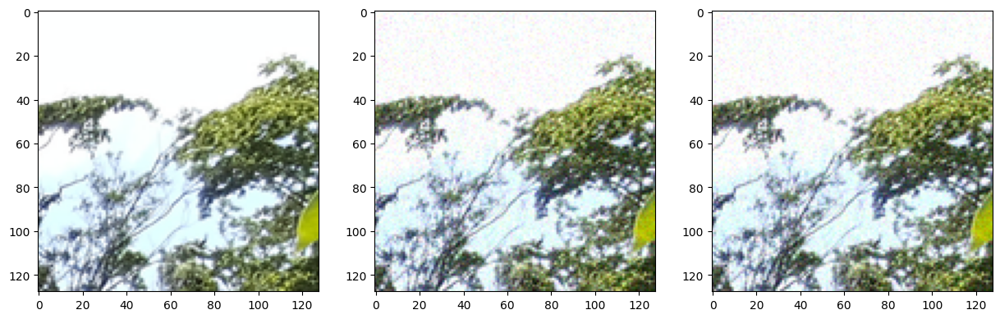

In [23]:
for patchs_noisy, patchs_true in data_train_batched:
    # with torch.autograd.set_detect_anomaly(True):
    with torch.no_grad():
        patchs_noisy = patchs_noisy.to(DEVICE)
        patchs_true = patchs_true.to(DEVICE)
        reconstruct_patchs = model(patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
    break


B = 2
img_true = np.clip(patchs_true[B].cpu().numpy(), a_min=0.0, a_max=100.0).astype(np.float64)
img_noisy = np.clip(patchs_noisy[B].cpu().numpy(), a_min=0.0, a_max=100.0).astype(np.float64)
img_recon = np.clip(reconstruct_patchs[B].cpu().numpy(), a_min=0.0, a_max=100.0).astype(np.float64)

fig, axs = plt.subplots( ncols=3, nrows=1, figsize=(15, 5))
axs[0].imshow(img_true)
axs[1].imshow(img_noisy)
axs[2].imshow(img_recon)
plt.show()

In [28]:
i=0
for patchs_noisy, patchs_true in data_train_batched:
    # with torch.autograd.set_detect_anomaly(True):
    s = time.time()
    optimizer.zero_grad()
    patchs_noisy = patchs_noisy.to(DEVICE)
    patchs_true = patchs_true.to(DEVICE)
    reconstruct_patchs = model(patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
    loss_value = criterian(reconstruct_patchs, patchs_true)
    loss_value.backward()
    optimizer.step()

    img_true = np.clip(patchs_true.detach().cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
    img_recon = np.clip(reconstruct_patchs.detach().cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
    train_mse_value = np.square(img_true- img_recon).mean()
    train_psnr = 10 * np.log10(1/train_mse_value)
    print(f"iter={i} time={time.time()-s} psnr={train_psnr} mse={train_mse_value}")
    i+=1

    if i == 10000:
        break

iter=0 time=0.25560665130615234 psnr=34.28034565054106 mse=0.00037322045237913015
iter=1 time=0.2329697608947754 psnr=29.106696096512724 mse=0.0012283733631519294
iter=2 time=0.24039483070373535 psnr=32.355152681773916 mse=0.0005814129916325716
iter=3 time=0.23907089233398438 psnr=31.53500254810247 mse=0.0007022629317023375
iter=4 time=0.23889517784118652 psnr=30.52154925562548 mse=0.0008868395939440721
iter=5 time=0.23261475563049316 psnr=32.73257658390426 mse=0.0005330185722075639
iter=6 time=0.23199844360351562 psnr=36.793691441174175 mse=0.00020923332463798755
iter=7 time=0.25911951065063477 psnr=33.765484568549184 mse=0.00042019564129943207
iter=8 time=0.24299883842468262 psnr=32.12367695959054 mse=0.0006132425827215482
iter=9 time=0.2383275032043457 psnr=30.924369582604605 mse=0.00080828225001588
iter=10 time=0.23909354209899902 psnr=31.49082136757693 mse=0.0007094435804280138
iter=11 time=0.24947571754455566 psnr=33.955333688467924 mse=0.0004022227501835605
iter=12 time=0.240293

In [27]:

train_dataset.random_permute_subselect_patchs_data(train_dataset.max_num_patchs)
data_train_batched = torch.utils.data.DataLoader(
    train_dataset, batch_size=4, num_workers=4
)

In [23]:
model.state_dict()

OrderedDict([('mixtureGLR_block03.alphaCGD',
              tensor([[ 0.6499,  0.1897,  0.6416,  0.4758],
                      [ 0.6950,  0.2355,  1.1636,  1.1578],
                      [ 0.2019,  0.1297,  0.0927, -0.0712],
                      [ 0.0024, -0.0796,  0.4403, -0.0168],
                      [ 0.2665,  0.1924,  1.2100,  0.6286],
                      [ 0.1227,  0.0515,  0.2850,  0.2260]], device='cuda:0')),
             ('mixtureGLR_block03.betaCGD',
              tensor([[ 0.1000,  0.1000,  0.1000,  0.1000],
                      [ 0.3251, -0.0834,  0.6076,  0.7578],
                      [ 0.1000,  0.1000,  0.1000,  0.1000],
                      [ 0.0756,  0.0103,  0.8493,  0.3390],
                      [ 0.1614,  0.1546,  0.6879,  0.4228],
                      [ 0.0631,  0.0012,  0.6778,  0.3608]], device='cuda:0')),
             ('mixtureGLR_block03.ro00',
              tensor([0.2759, 1.0134, 0.8987, 0.5054], device='cuda:0')),
             ('mixtureGLR_block03.ga

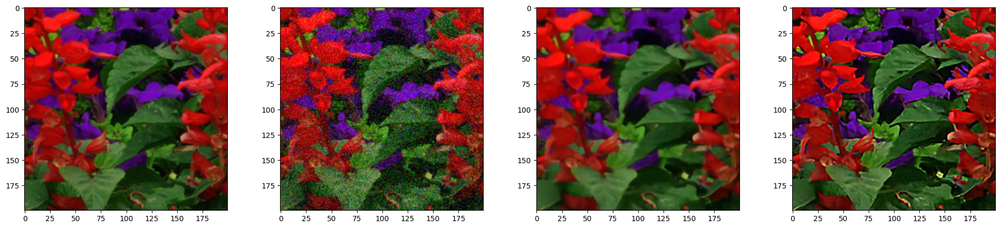

In [29]:
k = 0
###########
avg_kernel = 1.0 * torch.tensor([
    [0.0, -1.0, 0.0],
    [-1.0, 5.0, -1.0],
    [0.0, -1.0, 0.0],
])
kernel = []
for r in range(3):
    kernel.append(avg_kernel[np.newaxis, np.newaxis, :, :])

kernel = torch.concat(kernel, axis=0).to(DEVICE)


for patchs_noisy, patchs_true in data_test_batched:
    # with torch.autograd.set_detect_anomaly(True):
    if k == 2:
        with torch.no_grad():
            patchs_noisy = patchs_noisy.to(DEVICE)
            patchs_true = patchs_true.to(DEVICE)
            reconstruct_patchs = model(patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
            reconstruct_patchs_sharped = nn.functional.conv2d(
                reconstruct_patchs.permute(0, 3, 1, 2),
                weight=kernel,
                stride=1,
                padding=0,
                dilation=1,
                groups=3,
            ).permute(0, 2, 3, 1)
        break
    else:
        k+=1
        continue


B = 0
f,t = 200,400

img_true = np.clip(patchs_true[B].cpu().numpy()[f:t, f:t], a_min=0.0, a_max=100.0).astype(np.float64)
img_noisy = np.clip(patchs_noisy[B].cpu().numpy()[f:t, f:t], a_min=0.0, a_max=100.0).astype(np.float64)
img_recon = np.clip(reconstruct_patchs[B].cpu().numpy()[f:t, f:t], a_min=0.0, a_max=100.0).astype(np.float64)
img_recon2 = np.clip(reconstruct_patchs_sharped[B].cpu().numpy()[f:t, f:t], a_min=0.0, a_max=100.0).astype(np.float64)

fig, axs = plt.subplots( ncols=4, nrows=1, figsize=(24, 5))
axs[0].imshow(img_true)
axs[1].imshow(img_noisy)
axs[2].imshow(img_recon)
axs[3].imshow(img_recon2)
plt.show()

In [30]:
# ### VALIDAING
model.eval()
list_test_mse = []
test_i = 0
for test_patchs_noisy, test_patchs_true in data_test_batched:
    s = time.time()
    with torch.no_grad():
        test_patchs_noisy = test_patchs_noisy.to(DEVICE)
        test_patchs_true = test_patchs_true.to(DEVICE) 
        reconstruct_patchs = model(test_patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
        img_true = np.clip(test_patchs_true[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_noisy = np.clip(test_patchs_noisy[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_recon = np.clip(reconstruct_patchs[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        test_mse_value = np.square(img_true- img_recon).mean()
        list_test_mse.append(test_mse_value)
        print(f"test_i={test_i} time={time.time()-s} test_i_psnr_value={10 * np.log10(1/test_mse_value)}")

        # fig, axs = plt.subplots( ncols=3, nrows=1, figsize=(15, 5))
        # axs[0].imshow(img_true)
        # axs[1].imshow(img_noisy)
        # axs[2].imshow(img_recon)
        # plt.show()
    test_i+=1

psnr_testing = 10 * np.log10(1/np.array(list_test_mse))
print(f"FINISH TESING EPOCH {0} - iter={0} -  psnr_testing={np.mean(psnr_testing)}")
# model.train()

test_i=0 time=0.1575777530670166 test_i_psnr_value=34.33045167135153
test_i=1 time=0.15071725845336914 test_i_psnr_value=36.671053854990454
test_i=2 time=0.1442866325378418 test_i_psnr_value=29.968240984750768
test_i=3 time=0.14995169639587402 test_i_psnr_value=34.12055153897892
test_i=4 time=0.14982175827026367 test_i_psnr_value=33.16163328481999
test_i=5 time=0.1629493236541748 test_i_psnr_value=30.94441900249244
test_i=6 time=0.16528010368347168 test_i_psnr_value=32.972228297865755
test_i=7 time=0.16604351997375488 test_i_psnr_value=31.303985843895763
test_i=8 time=0.14707493782043457 test_i_psnr_value=28.535897990132092
test_i=9 time=0.14880061149597168 test_i_psnr_value=32.97404861569679
test_i=10 time=0.154616117477417 test_i_psnr_value=33.43518268643313
test_i=11 time=0.1538698673248291 test_i_psnr_value=33.33436342898766
test_i=12 time=0.15394353866577148 test_i_psnr_value=29.999195756377873
test_i=13 time=0.15370702743530273 test_i_psnr_value=32.229855168238316
test_i=14 time=

In [ ]:
# ### VALIDAING
model.eval()
list_test_mse = []
test_i = 0
for test_patchs_noisy, test_patchs_true in data_test_batched:
    s = time.time()
    with torch.no_grad():
        test_patchs_noisy = test_patchs_noisy.to(DEVICE)
        test_patchs_true = test_patchs_true.to(DEVICE) 
        reconstruct_patchs = model(test_patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
        img_true = np.clip(test_patchs_true[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_noisy = np.clip(test_patchs_noisy[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        img_recon = np.clip(reconstruct_patchs[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
        test_mse_value = np.square(img_true- img_recon).mean()
        list_test_mse.append(test_mse_value)
        print(f"test_i={test_i} time={time.time()-s} test_i_psnr_value={10 * np.log10(1/test_mse_value)}")

        # fig, axs = plt.subplots( ncols=3, nrows=1, figsize=(15, 5))
        # axs[0].imshow(img_true)
        # axs[1].imshow(img_noisy)
        # axs[2].imshow(img_recon)
        # plt.show()
    test_i+=1

psnr_testing = 10 * np.log10(1/np.array(list_test_mse))
print(f"FINISH TESING EPOCH {0} - iter={0} -  psnr_testing={np.mean(psnr_testing)}")
# model.train()

test_i=0 time=0.33909034729003906 test_i_psnr_value=31.28612121612123
test_i=1 time=0.3614003658294678 test_i_psnr_value=32.69841002906033
test_i=2 time=0.3717832565307617 test_i_psnr_value=27.803429840089414
test_i=3 time=0.36549925804138184 test_i_psnr_value=31.948411102087256
test_i=4 time=0.37434911727905273 test_i_psnr_value=30.62992208230099
test_i=5 time=0.3761763572692871 test_i_psnr_value=29.285273446943197
test_i=6 time=0.37595081329345703 test_i_psnr_value=30.51057556973598
test_i=7 time=0.370089054107666 test_i_psnr_value=29.473487031715916
test_i=8 time=0.37705230712890625 test_i_psnr_value=26.86861907940508
test_i=9 time=0.3777475357055664 test_i_psnr_value=29.76252903104209
test_i=10 time=0.37114834785461426 test_i_psnr_value=31.31634381949409
test_i=11 time=0.38167357444763184 test_i_psnr_value=31.303646100819925
test_i=12 time=0.3958244323730469 test_i_psnr_value=28.192073310207412
test_i=13 time=0.37050771713256836 test_i_psnr_value=29.754619943579435
test_i=14 time=0

# 08

In [1]:
import os, sys 
import itertools
import collections
import random
import time 
import logging

from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
from matplotlib.pyplot import imread

import torch
import torch.nn as nn
from torch.utils.data import Dataset
from torchvision.transforms import ToTensor
from torch.optim import Adam, AdamW
from torch.optim.lr_scheduler import MultiStepLR

#########################################################################################################
torch.set_float32_matmul_precision('high')
DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
ROOT_PROJECT = "/home/jovyan/shared/Thuc/hoodsgatedrive/projects/ImageRestoration-Development-Unrolling/"
ROOT_DATASET = "/home/jovyan/shared/Thuc/hoodsgatedrive/projects/"

#########################################################################################################

sys.path.append(os.path.join(ROOT_PROJECT, 'exploration/model_multiscale_mixture_GLR/lib'))
from dataloader import ImageSuperResolution


LOG_DIR = os.path.join(ROOT_PROJECT, "exploration/model_multiscale_mixture_GLR/result/model_test20/logs/")
LOGGER = logging.getLogger("main")
logging.basicConfig(
    format='%(asctime)s: %(message)s', 
    datefmt='%m/%d/%Y %I:%M:%S %p',
    filename=os.path.join(LOG_DIR, 'training00.log'), 
    level=logging.INFO
)

CHECKPOINT_DIR = os.path.join(ROOT_PROJECT, "exploration/model_multiscale_mixture_GLR/result/model_test20/checkpoints/")
VERBOSE_RATE = 1000

(H_train01, W_train01) = (64, 64)
(H_train02, W_train02) = (128, 128)
(H_train03, W_train03) = (256, 256)
(H_train04, W_train04) = (512, 512)

(H_val, W_val) = (128, 128)
(H_test, W_test) = (496, 496)

train_dataset01 = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/DFWB_training_data_info.csv"),
    dist_mode="vary_addictive_noise",
    lambda_noise=[[1.0, 10.0, 15.0, 20.0, 25.0], [0.1, 0.1, 0.1, 0.1, 0.6]],
    patch_size=(H_train01,H_train01),
    patch_overlap_size=(H_train01//4,H_train01//4),
    max_num_patchs=3200000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)
data_train_batched01 = torch.utils.data.DataLoader(
    train_dataset01, batch_size=16, num_workers=4
)

train_dataset02 = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/DFWB_training_data_info.csv"),
    dist_mode="vary_addictive_noise",
    lambda_noise=[[1.0, 10.0, 15.0, 20.0, 25.0], [0.1, 0.1, 0.1, 0.1, 0.6]],
    patch_size=(H_train02,H_train02),
    patch_overlap_size=(H_train02//2,H_train02//2),
    max_num_patchs=800000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)
data_train_batched02 = torch.utils.data.DataLoader(
    train_dataset02, batch_size=4, num_workers=4
)

train_dataset03 = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/DFWB_training_data_info.csv"),
    dist_mode="vary_addictive_noise",
    lambda_noise=[[1.0, 10.0, 15.0, 20.0, 25.0], [0.1, 0.1, 0.1, 0.1, 0.6]],
    patch_size=(H_train03,H_train03),
    patch_overlap_size=(H_train03//2,H_train03//2),
    max_num_patchs=400000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)
data_train_batched03 = torch.utils.data.DataLoader(
    train_dataset03, batch_size=4, num_workers=4
)

train_dataset04 = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/DFWB_training_data_info.csv"),
    dist_mode="vary_addictive_noise",
    lambda_noise=[[1.0, 10.0, 15.0, 20.0, 25.0], [0.1, 0.1, 0.1, 0.1, 0.6]],
    patch_size=(H_train04,H_train04),
    patch_overlap_size=(H_train04//2,H_train04//2),
    max_num_patchs=200000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)

data_train_batched04 = torch.utils.data.DataLoader(
    train_dataset04, batch_size=2, num_workers=4
)

validation_dataset = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/CBSD68_testing_data_info.csv"),
    dist_mode="addictive_noise",
    lambda_noise=25.0,
    patch_size=(H_val,H_val),
    patch_overlap_size=(H_val//2,H_val//2),
    max_num_patchs=1000000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)

test_dataset = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/McMaster_testing_data_info.csv"),
    dist_mode="addictive_noise",
    lambda_noise=25.0,
    patch_size=(H_test,H_test),
    patch_overlap_size=(0,0),
    max_num_patchs=1000000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)

data_valid_batched = torch.utils.data.DataLoader(
    validation_dataset, batch_size=16, num_workers=4
)

data_test_batched = torch.utils.data.DataLoader(
    test_dataset, batch_size=1, num_workers=4
)


In [8]:
import itertools
import collections
import numpy as np
import torch
import torch.nn as nn
from torch.nn.parameter import Parameter
from torch.profiler import profile, record_function, ProfilerActivity
# torch.set_default_dtype(torch.float64)

from einops import rearrange


class CustomLayerNorm(nn.Module):
    def __init__(self, nchannels):
        super(CustomLayerNorm, self).__init__()
        
        self.nchannels = nchannels
        self.weighted_transform = nn.Conv2d(nchannels, nchannels, kernel_size=1, stride=1, groups=nchannels, bias=False)

    def forward(self, x):
        # bz, nchannels, h, w = x.shape
        sigma = x.var(dim=1, keepdim=True, correction=1)
        return self.weighted_transform(x / torch.sqrt(sigma+1e-5))
    


##########################################################################
class FeedForward(nn.Module):
    def __init__(self, dim, ffn_expansion_factor, bias):
        super(FeedForward, self).__init__()

        hidden_features = int(dim*ffn_expansion_factor)
        # hidden_features = dim

        self.project_in = nn.Conv2d(dim, hidden_features*2, kernel_size=1, bias=bias)

        self.dwconv = nn.Conv2d(hidden_features*2, hidden_features*2, kernel_size=3, stride=1, padding=1, groups=hidden_features*2, bias=bias)

        self.project_out = nn.Conv2d(hidden_features, dim, kernel_size=1, bias=bias)

    def forward(self, x):
        x = self.project_in(x)
        x1, x2 = self.dwconv(x).chunk(2, dim=1)
        x = nn.functional.gelu(x1) * x2
        x = self.project_out(x)
        return x


##########################################################################
class FFBlock(nn.Module):
    def __init__(self, dim, ffn_expansion_factor, bias):
        super(FFBlock, self).__init__()

        self.norm = CustomLayerNorm(dim)

        self.skip_connect_weight_final = Parameter(
            torch.ones((2), dtype=torch.float32) * torch.tensor([0.5, 0.5]),
            requires_grad=True
        )
        self.ffn = FeedForward(dim, ffn_expansion_factor, bias)

    def forward(self, x):
        x = self.skip_connect_weight_final[0]*x + self.skip_connect_weight_final[1]*self.ffn(self.norm(x))

        return x



##########################################################################
## Overlapped image patch embedding with 3x3 Conv
class OverlapPatchEmbed(nn.Module):
    def __init__(self, in_c=3, embed_dim=48, bias=False):
        super(OverlapPatchEmbed, self).__init__()

        self.proj = nn.Conv2d(in_c, embed_dim, kernel_size=3, stride=1, padding=1, bias=bias)

    def forward(self, x):
        x = self.proj(x)

        return x



##########################################################################
## Resizing modules
class Downsample(nn.Module):
    def __init__(self, n_feat):
        super(Downsample, self).__init__()

        self.body = nn.Sequential(nn.Conv2d(n_feat, n_feat//2, kernel_size=3, stride=1, padding=1, bias=False),
                                  nn.PixelUnshuffle(2))

    def forward(self, x):
        return self.body(x)

class Upsample(nn.Module):
    def __init__(self, n_feat):
        super(Upsample, self).__init__()

        self.body = nn.Sequential(nn.Conv2d(n_feat, n_feat*2, kernel_size=3, stride=1, padding=1, bias=False),
                                  nn.PixelShuffle(2))

    def forward(self, x):
        return self.body(x)

##########################################################################
class FeatureExtraction(nn.Module):
    def __init__(self, 
        inp_channels=3, 
        out_channels=48, 
        dim = 48,
        num_blocks = [1,2,2,4], 
        num_refinement_blocks = 4,
        ffn_expansion_factor = 2.66,
        bias = False,
    ):

        super(FeatureExtraction, self).__init__()

        self.patch_embed = OverlapPatchEmbed(inp_channels, dim)

        self.encoder_level1 = nn.Sequential(*[FFBlock(dim=dim, ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[0])])
        
        self.down1_2 = Downsample(dim) ## From Level 1 to Level 2
        self.encoder_level2 = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[1])])
        
        self.down2_3 = Downsample(int(dim*2**1)) ## From Level 2 to Level 3
        self.encoder_level3 = nn.Sequential(*[FFBlock(dim=int(dim*2**2), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[2])])

        self.down3_4 = Downsample(int(dim*2**2)) ## From Level 3 to Level 4
        self.latent = nn.Sequential(*[FFBlock(dim=int(dim*2**3), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[3])])
        
        self.up4_3 = Upsample(int(dim*2**3)) ## From Level 4 to Level 3
        self.reduce_chan_level3 = nn.Conv2d(int(dim*2**3), int(dim*2**2), kernel_size=1, bias=bias)
        self.decoder_level3 = nn.Sequential(*[FFBlock(dim=int(dim*2**2), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[2])])


        self.up3_2 = Upsample(int(dim*2**2)) ## From Level 3 to Level 2
        self.reduce_chan_level2 = nn.Conv2d(int(dim*2**2), int(dim*2**1), kernel_size=1, bias=bias)
        self.decoder_level2 = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[1])])
        
        self.up2_1 = Upsample(int(dim*2**1))  ## From Level 2 to Level 1  (NO 1x1 conv to reduce channels)

        self.decoder_level1 = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[0])])
        
        self.refinement = nn.Sequential(*[FFBlock(dim=int(dim*2**1), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_refinement_blocks)])

        ###########################
        self.output = nn.Conv2d(int(dim*2**1), out_channels, kernel_size=3, stride=1, padding=1, bias=bias)

    def forward(self, inp_img):

        inp_enc_level1 = self.patch_embed(inp_img)
        out_enc_level1 = self.encoder_level1(inp_enc_level1)
        
        inp_enc_level2 = self.down1_2(out_enc_level1)
        out_enc_level2 = self.encoder_level2(inp_enc_level2)

        inp_enc_level3 = self.down2_3(out_enc_level2)
        out_enc_level3 = self.encoder_level3(inp_enc_level3) 

        inp_enc_level4 = self.down3_4(out_enc_level3)        
        latent = self.latent(inp_enc_level4) 
                        
        inp_dec_level3 = self.up4_3(latent)
        inp_dec_level3 = torch.cat([inp_dec_level3, out_enc_level3], 1)
        inp_dec_level3 = self.reduce_chan_level3(inp_dec_level3)
        out_dec_level3 = self.decoder_level3(inp_dec_level3) 

        inp_dec_level2 = self.up3_2(out_dec_level3)
        inp_dec_level2 = torch.cat([inp_dec_level2, out_enc_level2], 1)
        inp_dec_level2 = self.reduce_chan_level2(inp_dec_level2)
        out_dec_level2 = self.decoder_level2(inp_dec_level2) 

        inp_dec_level1 = self.up2_1(out_dec_level2)
        inp_dec_level1 = torch.cat([inp_dec_level1, out_enc_level1], 1)
        out_dec_level1 = self.decoder_level1(inp_dec_level1)
        
        out_dec_level1 = self.refinement(out_dec_level1)
        out_dec_level1 = self.output(out_dec_level1)

        # return [latent, out_dec_level3, out_dec_level2, out_dec_level1]
        return [out_dec_level1, out_dec_level2, out_dec_level3, latent]


class GLRFast(nn.Module):
    def __init__(self, 
            n_channels, n_node_fts, n_graphs, connection_window, device, M_diag_init=0.4
        ):
        super(GLRFast, self).__init__()

        self.device = device
        self.n_channels        = n_channels
        self.n_node_fts        = n_node_fts
        self.n_graphs          = n_graphs
        self.n_edges           = (connection_window == 1).sum()
        self.connection_window = connection_window
        self.buffer_size       = connection_window.sum()

        # edges type from connection_window
        window_size = connection_window.shape[0]
        connection_window = connection_window.reshape((-1))
        m = np.arange(window_size)-window_size//2
        edge_delta = np.array(
            list(itertools.product(m, m)),
            dtype=np.int32
        )
        self.edge_delta = edge_delta[connection_window == 1]
        
        self.pad_dim_hw = np.abs(self.edge_delta.min(axis=0))


        ### Trainable parameters
        # features on nodes #self.n_node_fts
        self.multiM = Parameter(
            torch.ones((self.n_graphs, self.n_node_fts), device=self.device, dtype=torch.float32)*M_diag_init,
            requires_grad=True,
        )


    def get_neighbors_pixels(self, img_features):
        _, _, H, W = img_features.shape
        padH, padW = self.pad_dim_hw
        img_features_frame = nn.functional.pad(img_features, (padW, padW, padH, padH), "replicate")
        neighbors_pixels = []
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            neighbors_pixels.append(
                img_features_frame[:, :, fromh:toh, fromw:tow]
            )
        neighbors_pixels_features = torch.stack(neighbors_pixels, axis=-3)

        return neighbors_pixels_features
    

    def normalize_and_transform_features(self, img_features):
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape
        # img_features = img_features.view(batch_size, self.n_graphs, self.n_node_fts, h_size, w_size)
        img_features = torch.nn.functional.normalize(img_features, dim=2)

        img_features_transform = torch.einsum(
            "bhcHW, hc -> bhcHW", img_features, self.multiM
        )
    
        img_features_transform = img_features_transform.view(batch_size, self.n_graphs*self.n_node_fts, h_size, w_size)

        return img_features_transform


    def extract_edge_weights(self, img_features):
        
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape

        img_features = self.normalize_and_transform_features(img_features)
        img_features_neighbors = self.get_neighbors_pixels(img_features)

        features_similarity = (img_features[:, :, None, :, :] * img_features_neighbors)
        features_similarity = features_similarity.view(
            batch_size, self.n_graphs, self.n_node_fts, self.n_edges, h_size, w_size
        ).sum(axis=2)

        edge_weights_norm = nn.functional.softmax(features_similarity, dim=2) 
        node_degree = edge_weights_norm.sum(axis=2)

        return edge_weights_norm, node_degree
    


    def op_L_norm(self, img_signals, edge_weights, node_degree):

        batch_size, n_graphs, n_channels, h_size, w_size = img_signals.shape
        img_features_neighbors = self.get_neighbors_pixels(
            img_signals.view(batch_size, n_graphs*n_channels, h_size, w_size)
        ).view(batch_size, n_graphs, n_channels, self.n_edges, h_size, w_size)
        Wx = torch.einsum(
            "bhceHW, bheHW -> bhcHW", img_features_neighbors, edge_weights
        )
        output = img_signals - Wx
        return output

    def forward(self, patchs, edge_weights, node_degree):
        output_patchs = self.op_L_norm(patchs, edge_weights, node_degree)
        return output_patchs
    



class GTVFast(nn.Module):
    def __init__(self, 
            n_channels, n_node_fts, n_graphs, connection_window, device, M_diag_init=0.4
        ):
        super(GTVFast, self).__init__()

        self.device = device
        self.n_channels        = n_channels
        self.n_node_fts        = n_node_fts
        self.n_graphs          = n_graphs
        self.n_edges           = (connection_window == 1).sum()
        self.connection_window = connection_window
        self.buffer_size       = connection_window.sum()

        # edges type from connection_window
        window_size = connection_window.shape[0]
        connection_window = connection_window.reshape((-1))
        m = np.arange(window_size)-window_size//2
        edge_delta = np.array(
            list(itertools.product(m, m)),
            dtype=np.int32
        )
        self.edge_delta = edge_delta[connection_window == 1]
        
        self.pad_dim_hw = np.abs(self.edge_delta.min(axis=0))


        ### Trainable parameters
        # features on nodes #self.n_node_fts
        self.multiM = Parameter(
            torch.ones((self.n_graphs, self.n_node_fts), device=self.device, dtype=torch.float32)*M_diag_init,
            requires_grad=True,
        )
        ############
        # avg_kernel = 1.0 * torch.tensor([
        #     [0.0, 0.0, 0.0],
        #     [0.0, 1.0, 0.0],
        #     [0.0, 0.0, 0.0],
        # ])
        # kernel = []
        # for r in range(self.n_channels):
        #     kernel.append(avg_kernel[np.newaxis, np.newaxis, :, :])

        # kernel = torch.concat(kernel, axis=0).to(self.device)
        # self.stats_kernel = Parameter(
        #     torch.ones((self.n_channels, 1, 3, 3), device=self.device, dtype=torch.float32) * kernel,
        #     requires_grad=True,
        # )

    def get_neighbors_pixels(self, img_features):
        _, _, H, W = img_features.shape
        padH, padW = self.pad_dim_hw
        img_features_frame = nn.functional.pad(img_features, (padW, padW, padH, padH), "replicate")
        neighbors_pixels = []
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            neighbors_pixels.append(
                img_features_frame[:, :, fromh:toh, fromw:tow]
            )
        neighbors_pixels_features = torch.stack(neighbors_pixels, axis=-3)

        return neighbors_pixels_features
    

    def normalize_and_transform_features(self, img_features):
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape
        # img_features = img_features.view(batch_size, self.n_graphs, self.n_node_fts, h_size, w_size)
        img_features = torch.nn.functional.normalize(img_features, dim=2)

        img_features_transform = torch.einsum(
            "bhcHW, hc -> bhcHW", img_features, self.multiM
        )
    
        img_features_transform = img_features_transform.view(batch_size, self.n_graphs*self.n_node_fts, h_size, w_size)

        return img_features_transform


    def extract_edge_weights(self, img_features):
        
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape

        img_features = self.normalize_and_transform_features(img_features)
        img_features_neighbors = self.get_neighbors_pixels(img_features)

        features_similarity = (img_features[:, :, None, :, :] * img_features_neighbors)
        features_similarity = features_similarity.view(
            batch_size, self.n_graphs, self.n_node_fts, self.n_edges, h_size, w_size
        ).sum(axis=2)

        edge_weights_norm = nn.functional.softmax(features_similarity, dim=2) 
        node_degree = edge_weights_norm.sum(axis=2)

        return edge_weights_norm, node_degree
    
    # def stats_conv(self, patchs):
    #     batch_size, n_graphs, c_size, h_size, w_size = patchs.shape
    #     temp_patch = patchs.view(batch_size*n_graphs, c_size, h_size, w_size)
    #     temp_patch = nn.functional.pad(temp_patch, (1,1,1,1), 'reflect')
    #     temp_out_patch = nn.functional.conv2d(
    #         temp_patch,
    #         weight=self.stats_kernel,
    #         stride=1,
    #         padding=0,
    #         dilation=1,
    #         groups=self.n_channels,
    #     )
    #     out_patch = temp_out_patch.view(batch_size, n_graphs, c_size, h_size, w_size)
    #     return out_patch

    # def stats_conv_transpose(self, patchs):
    #     batch_size, n_graphs, c_size, h_size, w_size = patchs.shape
    #     temp_patch = patchs.reshape(batch_size*n_graphs, c_size, h_size, w_size)
    #     temp_out_patch = nn.functional.conv_transpose2d(
    #         temp_patch,
    #         weight=self.stats_kernel,
    #         stride=1,
    #         padding=1,
    #         dilation=1,
    #         groups=self.n_channels,
    #     )
    #     out_patch = temp_out_patch.view(batch_size, n_graphs, c_size, h_size, h_size)
    #     return out_patch

    def op_C(self, img_signals, edge_weights, node_degree):


        batch_size, n_graphs, n_channels, h_size, w_size = img_signals.shape
        # img_signals = self.stats_conv(img_signals)

        img_features_neighbors = self.get_neighbors_pixels(
            img_signals.view(batch_size, n_graphs*n_channels, h_size, w_size)
        ).view(batch_size, n_graphs, n_channels, self.n_edges, h_size, w_size)
        Cx1 = img_signals[:, :, :, None, :, :] * edge_weights[:, :, None, :, :, :]
        Cx2 = img_features_neighbors * edge_weights[:, :, None, :, :, :]
        
        output = Cx1 - Cx2

        return output
    
    def op_C_transpose(self, edge_signals, edge_weights, node_degree):

        batch_size, n_graphs, n_channels, n_edges, H, W = edge_signals.shape
        edge_signals = edge_signals * edge_weights[:, :, None, :, :, :]

        output = edge_signals.sum(axis=3)

        padH, padW = self.pad_dim_hw
        output = nn.functional.pad(
            output.view(batch_size, n_graphs*n_channels, H, W),
            (padW, padW, padH, padH), "replicate"
        ).view(batch_size, n_graphs, n_channels, H + 2*padH, W + 2*padW)

        i=0
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            output[:, :, :, fromh:toh, fromw:tow] = output[:, :, :, fromh:toh, fromw:tow] - edge_signals[:, :, :, i, :, :]
            i+=1

        output = output[:, :, :, padH:-padH, padW:-padW]

        # output = self.stats_conv_transpose(output)
        return output

    def forward(self, patchs, edge_weights, node_degree):
        # C^T C
        edges_signals = self.op_C(patchs, edge_weights, node_degree)
        output_patchs = self.op_C_transpose(edges_signals, edge_weights, node_degree)

        return output_patchs
    

# #########################################################################
# class DCestimator(nn.Module):
#     def __init__(self, nchannels):
#         super(DCestimator, self).__init__()
#         self.n_channels = nchannels

#         avg_kernel = (1.0/25.0 ) * torch.tensor([
#             [1.0, 1.0, 1.0, 1.0, 1.0],
#             [1.0, 1.0, 1.0, 1.0, 1.0],
#             [1.0, 1.0, 1.0, 1.0, 1.0],
#             [1.0, 1.0, 1.0, 1.0, 1.0],
#             [1.0, 1.0, 1.0, 1.0, 1.0],
#         ])
#         kernel = []
#         for r in range(self.n_channels):
#             kernel.append(avg_kernel[np.newaxis, np.newaxis, :, :])

#         kernel = torch.concat(kernel, axis=0)
#         self.local_avg_kernel = Parameter(
#             torch.ones((self.n_channels, 1, 5, 5), dtype=torch.float32) * kernel,
#             requires_grad=True,
#         )

#     def forward(self, patchs):
    
#         patchs_padded = nn.functional.pad(patchs, (2, 2, 2, 2), "replicate")
#         out = nn.functional.conv2d(
#             patchs_padded,
#             self.local_avg_kernel,
#             bias=None,
#             stride=1,
#             padding=0,
#             groups=self.n_channels
#         )
#         return out


#########################################################################
class DCestimator(nn.Module):
    def __init__(self, dim_in, dim_out, hidden_features):
        super(DCestimator, self).__init__()

        self.project_in = nn.Conv2d(dim_in, hidden_features*2, kernel_size=1, bias=False)
        self.dwconv = nn.Conv2d(hidden_features*2, hidden_features*2, kernel_size=3, stride=1, padding=1, groups=hidden_features*2, bias=False)
        self.project_out = nn.Conv2d(hidden_features, dim_out, kernel_size=1, bias=False)

    def forward(self, patchs):

        out = self.project_in(patchs)
        out01, out02 = self.dwconv(out).chunk(2, dim=1)
        out = nn.functional.gelu(out01) * out02
        out = self.project_out(out)
        return out


class MixtureGTV(nn.Module):
    def __init__(self, 
            nchannels_in,
            n_graphs,
            n_node_fts,
            connection_window,
            n_cgd_iters,
            alpha_init,
            beta_init,
            muy_init, ro_init, gamma_init,
            device
        ):
        super(MixtureGTV, self).__init__()

        self.device       = device
        self.n_graphs     = n_graphs
        self.n_node_fts   = n_node_fts
        self.n_total_fts  = n_graphs * n_node_fts
        self.n_levels     = 4
        self.n_cgd_iters  = n_cgd_iters
        self.nchannels_in = nchannels_in
        self.connection_window = connection_window

        self.alphaCGD =  Parameter(
            torch.ones((self.n_cgd_iters, n_graphs), device=self.device, dtype=torch.float32) * alpha_init,
            requires_grad=True
        )

        self.betaCGD =  Parameter(
            torch.ones((self.n_cgd_iters, n_graphs), device=self.device, dtype=torch.float32) * beta_init,
            requires_grad=True
        )

        self.patchs_features_extraction = FeatureExtraction(
            inp_channels=3, 
            out_channels=self.n_total_fts, 
            dim = self.n_total_fts,
            num_blocks = [2, 3, 3, 4], 
            num_refinement_blocks = 4,
            ffn_expansion_factor = 2.66,
            bias = False,
        ).to(self.device)
        
        self.combination_weight = nn.Sequential(
            nn.Conv2d(
                in_channels=self.n_total_fts, 
                out_channels=self.n_graphs, 
                kernel_size=1,
                stride=1,
                padding=0,
                padding_mode="zeros",
                bias=False
            ),
            nn.Softmax(dim=1)
        ).to(self.device)
        self.dc_estimator = DCestimator(self.n_total_fts, 3, self.n_total_fts*2).to(self.device)


        self.ro00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * ro_init[0],
            requires_grad=True,
        )
        self.gamma00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * torch.log(gamma_init[0]),
            requires_grad=True,
        )
        self.GTVmodule00 = GTVFast(
            n_channels=self.nchannels_in,
            n_node_fts=self.n_node_fts,
            n_graphs=self.n_graphs,
            connection_window=self.connection_window,
            device=self.device,
            M_diag_init=1.0
        )

        self.muys00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * muy_init[0],
            requires_grad=True,
        )
        self.GLRmodule00 = GLRFast(
            n_channels=self.nchannels_in,
            n_node_fts=self.n_node_fts,
            n_graphs=self.n_graphs,
            connection_window=self.connection_window,
            device=self.device,
            M_diag_init=1.0
        )

    def apply_lightweight_transformer(self, patchs, list_graph_weightGTV, list_graph_weightGLR):

        batch_size, n_graphs, c_size, h_size, w_size = patchs.shape 
        patchs = patchs.contiguous()
        graph_weights, graph_degree = list_graph_weightGLR[0]

        Lpatchs = self.GLRmodule00(patchs, graph_weights, graph_degree)
        Lpatchs = torch.einsum(
            "bHchw, H -> bHchw", Lpatchs, self.muys00
        )

        graph_weights, graph_degree = list_graph_weightGTV[0]
        CtCpatchs = self.GTVmodule00(patchs, graph_weights, graph_degree)
        CtCpatchs = torch.einsum(
            "bHchw, H -> bHchw", CtCpatchs, self.ro00
        )

        output = patchs + Lpatchs + CtCpatchs

        return output
    
    def soft_threshold(self, delta, gamma):
        # batch_size, n_graphs, n_channels, n_edges, H, W = delta.shape
        # n_graphs = gamma.shape

        gamma = gamma[None, :, None, None, None, None]
        # print(f"Gamma.shape={gamma.shape}")

        condA = (delta < -gamma) 
        outputA = torch.where(
            condA,
            delta+gamma,
            0.0
        )
        condB = (delta > gamma) 
        outputB = torch.where(
            condB,
            delta-gamma,
            0.0
        )
        output = outputA + outputB
        return output


    def forward(self, patchs):
        # with record_function("MultiScaleMixtureGLR:forward"): 
        # print("#"*80)
        # patchs = patchs.permute(dims=(0, 3, 1, 2))
        # patchs = patchs.contiguous()
        # patchs = self.images_domain_to_abtract_domain(patchs)
        # print(f"patchs.shape={patchs.shape}")
        batch_size, c_size, h_size, w_size = patchs.shape

        #####
        ## Graph low pass filter
        
        list_features_patchs = self.patchs_features_extraction(patchs)
        list_graph_weightGTV = [None] * self.n_levels
        list_graph_weightGLR = [None] * self.n_levels
        bz, nfts, h, w = list_features_patchs[0].shape

        list_graph_weightGTV[0] = self.GTVmodule00.extract_edge_weights(
            list_features_patchs[0].view((bz, self.GTVmodule00.n_graphs, self.GTVmodule00.n_node_fts, h, w))
        )
        list_graph_weightGLR[0] = self.GLRmodule00.extract_edge_weights(
            list_features_patchs[0].view((bz, self.GLRmodule00.n_graphs, self.GLRmodule00.n_node_fts, h, w))
        )

        dc_term = self.dc_estimator(list_features_patchs[0])
        y_tilde = patchs - dc_term
        ###########################################################

        epsilon = self.GTVmodule00.op_C(y_tilde[:, None, :, :, :], list_graph_weightGTV[0][0], list_graph_weightGTV[0][1])
        bias    = torch.zeros_like(epsilon)

        left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
        left_hand_size *= self.ro00[None, :, None, None, None]
        left_hand_size += y_tilde[:, None, :, :, :]
        ############################################################
        output = left_hand_size
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual
        output = output + self.alphaCGD[0, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[1, None, :, None, None, None] * update
        output = output + self.alphaCGD[1, None, :, None, None, None] * update

        epsilon = self.soft_threshold(
            self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) + bias,
            torch.exp(self.gamma00)
        )
        bias  = bias + (self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) - epsilon)

        left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
        left_hand_size *= self.ro00[None, :, None, None, None]
        left_hand_size += y_tilde[:, None, :, :, :]
        ############################################################

        output = left_hand_size
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual
        output = output + self.alphaCGD[2, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[3, None, :, None, None, None] * update
        output = output + self.alphaCGD[3, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[4, None, :, None, None, None] * update
        output = output + self.alphaCGD[4, None, :, None, None, None] * update
        
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[5, None, :, None, None, None] * update
        output = output + self.alphaCGD[5, None, :, None, None, None] * update
        

        score = self.combination_weight(list_features_patchs[0])
        output = torch.einsum(
            "bgchw, bghw -> bchw", output, score
        ) + dc_term

        return output


#########################################################################
class SharpeningBlock(nn.Module):
    def __init__(self, dim_in, dim_out, hidden_features):
        super(SharpeningBlock, self).__init__()

        self.project_in = nn.Conv2d(dim_in, hidden_features*2, kernel_size=1, bias=False)
        self.dwconv = nn.Conv2d(hidden_features*2, hidden_features*2, kernel_size=3, stride=1, padding=1, groups=hidden_features*2, bias=False)
        self.project_out = nn.Conv2d(hidden_features, dim_out, kernel_size=1, bias=False)
        self.skip_connect_weight = Parameter(
            torch.ones((2), dtype=torch.float32) * torch.tensor([0.5, 0.5]),
            requires_grad=True
        )
        
    def forward(self, patchs):

        out = self.project_in(patchs)
        out01, out02 = self.dwconv(out).chunk(2, dim=1)
        out = nn.functional.gelu(out01) * out02
        out = self.project_out(out)
        out = self.skip_connect_weight[0] * patchs + self.skip_connect_weight[1] * out
        return out


class MultiScaleSequenceDenoiser(nn.Module):
    def __init__(self, device):
        super(MultiScaleSequenceDenoiser, self).__init__()
        self.device = device

        CONNECTION_FLAGS_3x3= np.array([
            1,1,1,
            1,0,1,
            1,1,1,
        ]).reshape((3,3))

        CONNECTION_FLAGS_5x5 = np.array([
            1,1,1,1,1,
            1,1,1,1,1,
            1,1,0,1,1,
            1,1,1,1,1,
            1,1,1,1,1,
        ]).reshape((5,5))

        # self.skip_connect_weight01 = Parameter(
        #     torch.ones((2), dtype=torch.float32, device=device) * torch.tensor([0.1, 0.9]).to(device),
        #     requires_grad=True
        # )
        # self.mixtureGLR_block01 = MixtureGTV(
        #     nchannels_in=3,
        #     n_graphs=4,
        #     n_node_fts=6,
        #     connection_window=CONNECTION_FLAGS_3x3,
        #     n_cgd_iters=6,
        #     alpha_init=0.5,
        #     beta_init=0.1,
        #     muy_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
        #     ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
        #     gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(self.device),
        #     device=self.device
        # )
        # self.sharp01 = SharpeningBlock(3, 3, 24).to(device)
        

        # self.skip_connect_weight02 = Parameter(
        #     torch.ones((2), dtype=torch.float32, device=device) * torch.tensor([0.1, 0.9]).to(device),
        #     requires_grad=True
        # )
        # self.mixtureGLR_block02 = MixtureGTV(
        #     nchannels_in=3,
        #     n_graphs=4,
        #     n_node_fts=6,
        #     connection_window=CONNECTION_FLAGS_3x3,
        #     n_cgd_iters=6,
        #     alpha_init=0.5,
        #     beta_init=0.1,
        #     muy_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
        #     ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
        #     gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(self.device),
        #     device=self.device
        # )
        # self.sharp02 = SharpeningBlock(3, 3, 24).to(device)
        

        self.skip_connect_weight03 = Parameter(
            torch.ones((2), dtype=torch.float32, device=self.device) * torch.tensor([0.1, 0.9]).to(device),
            requires_grad=True
        )
        self.mixtureGLR_block03 = MixtureGTV(
            nchannels_in=3,
            n_graphs=4,
            n_node_fts=12,
            connection_window=CONNECTION_FLAGS_5x5,
            n_cgd_iters=6,
            alpha_init=0.5,
            beta_init=0.1,
            muy_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
            ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
            gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(self.device),
            device=self.device
        )
        # self.sharp03 = SharpeningBlock(3, 3, 24).to(device)
        
    
    def forward(self, patchs):

        # output = self.skip_connect_weight_01[0] * patchs + self.skip_connect_weight_01[1] * self.sharp01(self.mixtureGLR_block01(patchs))
        # output = self.skip_connect_weight_02[0] * output + self.skip_connect_weight_02[1] * self.sharp02(self.mixtureGLR_block02(output))
        
        # output = self.skip_connect_weight01[0] * patchs + self.skip_connect_weight01[1] * self.mixtureGLR_block01(patchs)
        # output = self.sharp01(output)

        # output = self.skip_connect_weight02[0] * output + self.skip_connect_weight02[1] * self.mixtureGLR_block02(output)
        # output = self.sharp02(output)

        # output = self.skip_connect_weight03[0] * output + self.skip_connect_weight03[1] * self.mixtureGLR_block03(output)
        # output = self.sharp03(output)

        output = self.skip_connect_weight03[0] * patchs + self.skip_connect_weight03[1] * self.mixtureGLR_block03(patchs)
        # output = self.sharp03(output)

        return output


In [9]:

model = MultiScaleSequenceDenoiser(device=DEVICE)

s = 0
for p in model.parameters():
    s += np.prod(np.array(p.shape))

print(f"Init model with total parameters: {s}")

criterian = nn.L1Loss()
optimizer = Adam(
    model.parameters(),
    lr=0.0003,
    eps=1e-08
)
lr_scheduler = MultiStepLR(
    optimizer,
    milestones=[500000, 700000, 900000], gamma=0.5
)

Init model with total parameters: 11425298


In [10]:

model.train()

i = 0
### TRAINING
list_train_mse = []
list_train_psnr = []
combined_dataloader = itertools.chain(data_train_batched01, data_train_batched02, data_train_batched03, data_train_batched04)
for patchs_noisy, patchs_true in combined_dataloader:
    s = time.time()
    optimizer.zero_grad()
    patchs_noisy = patchs_noisy.to(DEVICE)
    patchs_true = patchs_true.to(DEVICE) 
    reconstruct_patchs = model(patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
    loss_value = criterian(reconstruct_patchs, patchs_true)
    loss_value.backward()
    optimizer.step()
    lr_scheduler.step()

    img_true = np.clip(patchs_true.detach().cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
    img_recon = np.clip(reconstruct_patchs.detach().cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
    train_mse_value = np.square(img_true- img_recon).mean()
    train_psnr = 10 * np.log10(1/train_mse_value)
    list_train_psnr.append(train_psnr)
    list_train_mse.append(train_mse_value)


    if (i%(VERBOSE_RATE//10) == 0):
        print(f"iter={i} time={time.time()-s} psnr={np.mean(list_train_psnr[-100:])} mse={np.mean(list_train_mse[-100:])}")
        list_train_mse  = list_train_mse[-100:].copy()
        list_train_psnr = list_train_psnr[-100:].copy()


    if (i%VERBOSE_RATE == 0):
        model.eval()
        list_test_mse = []
        test_i = 0
        for test_patchs_noisy, test_patchs_true in data_test_batched:
            s = time.time()
            with torch.no_grad():
                test_patchs_noisy = test_patchs_noisy.to(DEVICE)
                test_patchs_true = test_patchs_true.to(DEVICE) 
                reconstruct_patchs = model(test_patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
                img_true = np.clip(test_patchs_true[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
                img_recon = np.clip(reconstruct_patchs[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
                test_mse_value = np.square(img_true- img_recon).mean()
                list_test_mse.append(test_mse_value)
                # print(f"test_i={test_i} time={time.time()-s} test_i_psnr_value={10 * np.log10(1/test_mse_value)}")
            test_i+=1

        psnr_testing = 10 * np.log10(1/np.array(list_test_mse))
        print(f"FINISH TESING EPOCH {0} - iter={i} -  psnr_testing={np.mean(psnr_testing)}")
        model.train()

    if i==20000:
        break

    i+=1

iter=0 time=0.4596390724182129 psnr=21.61245213673727 mse=0.006898501869537427
FINISH TESING EPOCH 0 - iter=0 -  psnr_testing=21.581861753687708
iter=100 time=0.28313398361206055 psnr=23.06985135985291 mse=0.0049814625392410284
iter=200 time=0.2862107753753662 psnr=23.161986920394064 mse=0.004879403470388817
iter=300 time=0.29265904426574707 psnr=23.709619772579302 mse=0.0043143521088420435
iter=400 time=0.28664159774780273 psnr=25.26308841757527 mse=0.0030456990600347005
iter=500 time=0.2853274345397949 psnr=28.103674038991315 mse=0.0016066635944763155
iter=600 time=0.2857789993286133 psnr=30.280405647283718 mse=0.0009606928319703568
iter=700 time=0.28411388397216797 psnr=31.010127361355025 mse=0.0008142655176885348
iter=800 time=0.28292155265808105 psnr=31.456599023048952 mse=0.0007366434043303814
iter=900 time=0.2861175537109375 psnr=31.570455080242173 mse=0.0007181336182954216
iter=1000 time=0.2922360897064209 psnr=31.561476185242082 mse=0.0007174058841078955
FINISH TESING EPOCH 0 

# 09

In [ ]:
import os, sys 
import itertools
import collections
import random
import time 
import logging

from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
from matplotlib.pyplot import imread

import torch
import torch.nn as nn
from torch.utils.data import Dataset
from torchvision.transforms import ToTensor
from torch.optim import Adam, AdamW
from torch.optim.lr_scheduler import MultiStepLR

#########################################################################################################
torch.set_float32_matmul_precision('high')
DEVICE = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
ROOT_PROJECT = "/home/jovyan/shared/Thuc/hoodsgatedrive/projects/ImageRestoration-Development-Unrolling/"
ROOT_DATASET = "/home/jovyan/shared/Thuc/hoodsgatedrive/projects/"
# ROOT_PROJECT = "/home/dotamthuc/Works/Projects/ImageRestoration-Development-Unrolling/"
# ROOT_DATASET = "/home/dotamthuc/Works/Projects/ImageRestoration-Development-Unrolling"

#########################################################################################################

sys.path.append(os.path.join(ROOT_PROJECT, 'exploration/model_multiscale_mixture_GLR/lib'))
from dataloader import ImageSuperResolution


In [ ]:


LOG_DIR = os.path.join(ROOT_PROJECT, "exploration/model_multiscale_mixture_GLR/result/model_test21/logs/")
LOGGER = logging.getLogger("main")
logging.basicConfig(
    format='%(asctime)s: %(message)s', 
    datefmt='%m/%d/%Y %I:%M:%S %p',
    filename=os.path.join(LOG_DIR, 'training00.log'), 
    level=logging.INFO
)

CHECKPOINT_DIR = os.path.join(ROOT_PROJECT, "exploration/model_multiscale_mixture_GLR/result/model_test21/checkpoints/")
VERBOSE_RATE = 1000

(H_train01, W_train01) = (64, 64)
(H_train02, W_train02) = (128, 128)
(H_train03, W_train03) = (256, 256)
(H_train04, W_train04) = (512, 512)

(H_val, W_val) = (128, 128)
(H_test, W_test) = (496, 496)

train_dataset01 = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/DFWB_training_data_info.csv"),
    dist_mode="vary_addictive_noise",
    lambda_noise=[[1.0, 10.0, 15.0, 20.0, 25.0], [0.1, 0.1, 0.1, 0.1, 0.6]],
    use_data_aug=True,
    patch_size=(H_train01,H_train01),
    patch_overlap_size=(H_train01//4,H_train01//4),
    max_num_patchs=3200000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)
data_train_batched01 = torch.utils.data.DataLoader(
    train_dataset01, batch_size=16, num_workers=4
)

train_dataset02 = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/DFWB_training_data_info.csv"),
    dist_mode="vary_addictive_noise",
    lambda_noise=[[1.0, 10.0, 15.0, 20.0, 25.0], [0.1, 0.1, 0.1, 0.1, 0.6]],
    use_data_aug=True,
    patch_size=(H_train02,H_train02),
    patch_overlap_size=(H_train02//2,H_train02//2),
    max_num_patchs=800000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)
data_train_batched02 = torch.utils.data.DataLoader(
    train_dataset02, batch_size=4, num_workers=4
)

train_dataset03 = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/DFWB_training_data_info.csv"),
    dist_mode="vary_addictive_noise",
    lambda_noise=[[1.0, 10.0, 15.0, 20.0, 25.0], [0.1, 0.1, 0.1, 0.1, 0.6]],
    use_data_aug=True,
    patch_size=(H_train03,H_train03),
    patch_overlap_size=(H_train03//2,H_train03//2),
    max_num_patchs=400000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)
data_train_batched03 = torch.utils.data.DataLoader(
    train_dataset03, batch_size=4, num_workers=4
)

train_dataset04 = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/DFWB_training_data_info.csv"),
    dist_mode="vary_addictive_noise",
    lambda_noise=[[1.0, 10.0, 15.0, 20.0, 25.0], [0.1, 0.1, 0.1, 0.1, 0.6]],
    use_data_aug=True,
    patch_size=(H_train04,H_train04),
    patch_overlap_size=(H_train04//2,H_train04//2),
    max_num_patchs=200000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)

data_train_batched04 = torch.utils.data.DataLoader(
    train_dataset04, batch_size=2, num_workers=4
)

validation_dataset = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/CBSD68_testing_data_info.csv"),
    dist_mode="addictive_noise",
    lambda_noise=25.0,
    patch_size=(H_val,H_val),
    patch_overlap_size=(H_val//2,H_val//2),
    max_num_patchs=1000000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)

test_dataset = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/McMaster_testing_data_info.csv"),
    dist_mode="addictive_noise",
    lambda_noise=25.0,
    patch_size=(H_test,H_test),
    patch_overlap_size=(0,0),
    max_num_patchs=1000000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)

data_valid_batched = torch.utils.data.DataLoader(
    validation_dataset, batch_size=16, num_workers=4
)

data_test_batched = torch.utils.data.DataLoader(
    test_dataset, batch_size=1, num_workers=4
)


In [2]:
import itertools
import collections
import numpy as np
import torch
import torch.nn as nn
from torch.nn.parameter import Parameter
from torch.profiler import profile, record_function, ProfilerActivity
# torch.set_default_dtype(torch.float64)

from einops import rearrange


class CustomLayerNorm(nn.Module):
    def __init__(self, nchannels):
        super(CustomLayerNorm, self).__init__()
        
        self.nchannels = nchannels
        self.weighted_transform = nn.Conv2d(nchannels, nchannels, kernel_size=1, stride=1, groups=nchannels, bias=False)

    def forward(self, x):
        # bz, nchannels, h, w = x.shape
        sigma = x.var(dim=1, keepdim=True, correction=1)
        # bz, 1, h, w = sigma.shape
        return self.weighted_transform(x / torch.sqrt(sigma+1e-5))
    


##########################################################################
class FeedForward(nn.Module):
    def __init__(self, dim, ffn_expansion_factor, bias):
        super(FeedForward, self).__init__()

        hidden_features = int(dim*ffn_expansion_factor)
        # hidden_features = dim

        self.project_in = nn.Conv2d(dim, hidden_features*2, kernel_size=1, bias=bias)

        self.dwconv = nn.Conv2d(hidden_features*2, hidden_features*2, kernel_size=3, stride=1, padding=1, groups=hidden_features*2, bias=bias)

        self.project_out = nn.Conv2d(hidden_features, dim, kernel_size=1, bias=bias)

    def forward(self, x):
        x = self.project_in(x)
        x1, x2 = self.dwconv(x).chunk(2, dim=1)
        x = nn.functional.gelu(x1) * x2
        x = self.project_out(x)
        return x


##########################################################################
class FFBlock(nn.Module):
    def __init__(self, dim, ffn_expansion_factor, bias):
        super(FFBlock, self).__init__()

        self.norm = CustomLayerNorm(dim)

        self.skip_connect_weight_final = Parameter(
            torch.ones((2), dtype=torch.float32) * torch.tensor([0.5, 0.5]),
            requires_grad=True
        )
        self.ffn = FeedForward(dim, ffn_expansion_factor, bias)

    def forward(self, x):
        x = self.skip_connect_weight_final[0]*x + self.skip_connect_weight_final[1]*self.ffn(self.norm(x))

        return x



##########################################################################
## Overlapped image patch embedding with 3x3 Conv
class OverlapPatchEmbed(nn.Module):
    def __init__(self, in_c=3, embed_dim=48, bias=False):
        super(OverlapPatchEmbed, self).__init__()

        self.proj = nn.Conv2d(in_c, embed_dim, kernel_size=3, stride=1, padding=1, bias=bias)

    def forward(self, x):
        x = self.proj(x)

        return x



##########################################################################
## Resizing modules
class Downsample(nn.Module):
    def __init__(self, n_feat):
        super(Downsample, self).__init__()

        # self.body = nn.Sequential(nn.Conv2d(n_feat, n_feat//2, kernel_size=3, stride=1, padding=1, bias=False),
        #                           nn.PixelUnshuffle(2))

        self.body = nn.Sequential(nn.Conv2d(n_feat, n_feat//4, kernel_size=3, stride=1, padding=1, bias=False),
                                  nn.PixelUnshuffle(2))
        
        # self.body = nn.Sequential(nn.Conv2d(n_feat, n_feat, kernel_size=3, stride=2, padding=1, padding_mode="replicate", bias=False))

    def forward(self, x):
        return self.body(x)

class Upsample(nn.Module):
    def __init__(self, n_feat):
        super(Upsample, self).__init__()

        # self.body = nn.Sequential(nn.Conv2d(n_feat, n_feat*2, kernel_size=3, stride=1, padding=1, bias=False),
        #                           nn.PixelShuffle(2))
        self.body = nn.Sequential(nn.Conv2d(n_feat, n_feat*4, kernel_size=3, stride=1, padding=1, bias=False),
                                  nn.PixelShuffle(2))

        # self.body = nn.Sequential(nn.ConvTranspose2d(n_feat, n_feat, kernel_size=3, stride=2, padding=1, output_padding=1, bias=False))


    def forward(self, x):
        return self.body(x)

##########################################################################
class FeatureExtraction(nn.Module):
    def __init__(self, 
        inp_channels=3, 
        out_channels=48, 
        dim = 48,
        num_blocks = [1,2,2,4], 
        num_refinement_blocks = 4,
        ffn_expansion_factor = 2.66,
        bias = False,
    ):

        super(FeatureExtraction, self).__init__()

        self.patch_embed = OverlapPatchEmbed(inp_channels, dim)

        self.encoder_level1 = nn.Sequential(*[FFBlock(dim=dim, ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[0])])
        
        self.down1_2 = Downsample(dim) ## From Level 1 to Level 2
        self.encoder_level2 = nn.Sequential(*[FFBlock(dim=int(dim), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[1])])
        
        self.down2_3 = Downsample(int(dim)) ## From Level 2 to Level 3
        self.encoder_level3 = nn.Sequential(*[FFBlock(dim=int(dim), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[2])])

        self.down3_4 = Downsample(int(dim)) ## From Level 3 to Level 4
        self.latent = nn.Sequential(*[FFBlock(dim=int(dim), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[3])])
        
        self.up4_3 = Upsample(int(dim)) ## From Level 4 to Level 3
        self.reduce_chan_level3 = nn.Conv2d(int(dim*2), int(dim), kernel_size=1, bias=bias)
        self.decoder_level3 = nn.Sequential(*[FFBlock(dim=int(dim), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[2])])

        self.up3_2 = Upsample(int(dim)) ## From Level 3 to Level 2
        self.reduce_chan_level2 = nn.Conv2d(int(dim*2), int(dim), kernel_size=1, bias=bias)
        self.decoder_level2 = nn.Sequential(*[FFBlock(dim=int(dim), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[1])])
        
        self.up2_1 = Upsample(int(dim))  ## From Level 2 to Level 1  (NO 1x1 conv to reduce channels)

        self.decoder_level1 = nn.Sequential(*[FFBlock(dim=int(dim*2), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_blocks[0])])
        
        self.refinement = nn.Sequential(*[FFBlock(dim=int(dim*2), ffn_expansion_factor=ffn_expansion_factor, bias=bias) for i in range(num_refinement_blocks)])

        ###########################
        self.output = nn.Conv2d(int(dim*2), out_channels, kernel_size=3, stride=1, padding=1, bias=bias)

    def forward(self, inp_img):

        inp_enc_level1 = self.patch_embed(inp_img)
        out_enc_level1 = self.encoder_level1(inp_enc_level1)
        
        inp_enc_level2 = self.down1_2(out_enc_level1)
        out_enc_level2 = self.encoder_level2(inp_enc_level2)

        inp_enc_level3 = self.down2_3(out_enc_level2)
        out_enc_level3 = self.encoder_level3(inp_enc_level3) 

        inp_enc_level4 = self.down3_4(out_enc_level3)        
        latent = self.latent(inp_enc_level4) 
                        
        inp_dec_level3 = self.up4_3(latent)
        inp_dec_level3 = torch.cat([inp_dec_level3, out_enc_level3], 1)
        inp_dec_level3 = self.reduce_chan_level3(inp_dec_level3)
        out_dec_level3 = self.decoder_level3(inp_dec_level3) 

        inp_dec_level2 = self.up3_2(out_dec_level3)
        inp_dec_level2 = torch.cat([inp_dec_level2, out_enc_level2], 1)
        inp_dec_level2 = self.reduce_chan_level2(inp_dec_level2)
        out_dec_level2 = self.decoder_level2(inp_dec_level2) 

        inp_dec_level1 = self.up2_1(out_dec_level2)
        inp_dec_level1 = torch.cat([inp_dec_level1, out_enc_level1], 1)
        out_dec_level1 = self.decoder_level1(inp_dec_level1)
        
        out_dec_level1 = self.refinement(out_dec_level1)
        out_dec_level1 = self.output(out_dec_level1)

        # return [latent, out_dec_level3, out_dec_level2, out_dec_level1]
        return [out_dec_level1]


class GLRFast(nn.Module):
    def __init__(self, 
            n_channels, n_node_fts, n_graphs, connection_window, device, M_diag_init=0.4
        ):
        super(GLRFast, self).__init__()

        self.device = device
        self.n_channels        = n_channels
        self.n_node_fts        = n_node_fts
        self.n_graphs          = n_graphs
        self.n_edges           = (connection_window == 1).sum()
        self.connection_window = connection_window
        self.buffer_size       = connection_window.sum()

        # edges type from connection_window
        window_size = connection_window.shape[0]
        connection_window = connection_window.reshape((-1))
        m = np.arange(window_size)-window_size//2
        edge_delta = np.array(
            list(itertools.product(m, m)),
            dtype=np.int32
        )
        self.edge_delta = edge_delta[connection_window == 1]
        
        self.pad_dim_hw = np.abs(self.edge_delta.min(axis=0))


        ### Trainable parameters
        # features on nodes #self.n_node_fts
        self.multiM = Parameter(
            torch.ones((self.n_graphs, self.n_node_fts), device=self.device, dtype=torch.float32)*M_diag_init,
            requires_grad=True,
        )


    def get_neighbors_pixels(self, img_features):
        _, _, H, W = img_features.shape
        padH, padW = self.pad_dim_hw
        img_features_frame = nn.functional.pad(img_features, (padW, padW, padH, padH), "replicate")
        neighbors_pixels = []
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            neighbors_pixels.append(
                img_features_frame[:, :, fromh:toh, fromw:tow]
            )
        neighbors_pixels_features = torch.stack(neighbors_pixels, axis=-3)

        return neighbors_pixels_features
    

    def normalize_and_transform_features(self, img_features):
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape
        # img_features = img_features.view(batch_size, self.n_graphs, self.n_node_fts, h_size, w_size)
        img_features = torch.nn.functional.normalize(img_features, dim=2)

        img_features_transform = torch.einsum(
            "bhcHW, hc -> bhcHW", img_features, self.multiM
        )
    
        img_features_transform = img_features_transform.view(batch_size, self.n_graphs*self.n_node_fts, h_size, w_size)

        return img_features_transform


    def extract_edge_weights(self, img_features):
        
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape

        img_features = self.normalize_and_transform_features(img_features)
        img_features_neighbors = self.get_neighbors_pixels(img_features)

        features_similarity = (img_features[:, :, None, :, :] * img_features_neighbors)
        features_similarity = features_similarity.view(
            batch_size, self.n_graphs, self.n_node_fts, self.n_edges, h_size, w_size
        ).sum(axis=2)

        edge_weights_norm = nn.functional.softmax(features_similarity, dim=2) 
        node_degree = edge_weights_norm.sum(axis=2)

        return edge_weights_norm, node_degree
    


    def op_L_norm(self, img_signals, edge_weights, node_degree):

        batch_size, n_graphs, n_channels, h_size, w_size = img_signals.shape
        img_features_neighbors = self.get_neighbors_pixels(
            img_signals.view(batch_size, n_graphs*n_channels, h_size, w_size)
        ).view(batch_size, n_graphs, n_channels, self.n_edges, h_size, w_size)
        Wx = torch.einsum(
            "bhceHW, bheHW -> bhcHW", img_features_neighbors, edge_weights
        )
        output = img_signals - Wx
        return output

    def forward(self, patchs, edge_weights, node_degree):
        output_patchs = self.op_L_norm(patchs, edge_weights, node_degree)
        return output_patchs
    



class GTVFast(nn.Module):
    def __init__(self, 
            n_channels, n_node_fts, n_graphs, connection_window, device, M_diag_init=0.4
        ):
        super(GTVFast, self).__init__()

        self.device = device
        self.n_channels        = n_channels
        self.n_node_fts        = n_node_fts
        self.n_graphs          = n_graphs
        self.n_edges           = (connection_window == 1).sum()
        self.connection_window = connection_window
        self.buffer_size       = connection_window.sum()

        # edges type from connection_window
        window_size = connection_window.shape[0]
        connection_window = connection_window.reshape((-1))
        m = np.arange(window_size)-window_size//2
        edge_delta = np.array(
            list(itertools.product(m, m)),
            dtype=np.int32
        )
        self.edge_delta = edge_delta[connection_window == 1]
        
        self.pad_dim_hw = np.abs(self.edge_delta.min(axis=0))


        ### Trainable parameters
        # features on nodes #self.n_node_fts
        self.multiM = Parameter(
            torch.ones((self.n_graphs, self.n_node_fts), device=self.device, dtype=torch.float32)*M_diag_init,
            requires_grad=True,
        )
        ############
        # avg_kernel = 1.0 * torch.tensor([
        #     [0.0, 0.0, 0.0],
        #     [0.0, 1.0, 0.0],
        #     [0.0, 0.0, 0.0],
        # ])
        # kernel = []
        # for r in range(self.n_channels):
        #     kernel.append(avg_kernel[np.newaxis, np.newaxis, :, :])

        # kernel = torch.concat(kernel, axis=0).to(self.device)
        # self.stats_kernel = Parameter(
        #     torch.ones((self.n_channels, 1, 3, 3), device=self.device, dtype=torch.float32) * kernel,
        #     requires_grad=True,
        # )

    def get_neighbors_pixels(self, img_features):
        _, _, H, W = img_features.shape
        padH, padW = self.pad_dim_hw
        img_features_frame = nn.functional.pad(img_features, (padW, padW, padH, padH), "replicate")
        neighbors_pixels = []
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            neighbors_pixels.append(
                img_features_frame[:, :, fromh:toh, fromw:tow]
            )
        neighbors_pixels_features = torch.stack(neighbors_pixels, axis=-3)

        return neighbors_pixels_features
    

    def normalize_and_transform_features(self, img_features):
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape
        # img_features = img_features.view(batch_size, self.n_graphs, self.n_node_fts, h_size, w_size)
        img_features = torch.nn.functional.normalize(img_features, dim=2)

        img_features_transform = torch.einsum(
            "bhcHW, hc -> bhcHW", img_features, self.multiM
        )
    
        img_features_transform = img_features_transform.view(batch_size, self.n_graphs*self.n_node_fts, h_size, w_size)

        return img_features_transform


    def extract_edge_weights(self, img_features):
        
        batch_size, n_graphs, n_node_fts, h_size, w_size = img_features.shape

        img_features = self.normalize_and_transform_features(img_features)
        img_features_neighbors = self.get_neighbors_pixels(img_features)

        features_similarity = (img_features[:, :, None, :, :] * img_features_neighbors)
        features_similarity = features_similarity.view(
            batch_size, self.n_graphs, self.n_node_fts, self.n_edges, h_size, w_size
        ).sum(axis=2)

        edge_weights_norm = nn.functional.softmax(features_similarity, dim=2) 
        node_degree = edge_weights_norm.sum(axis=2)

        return edge_weights_norm, node_degree
    
    # def stats_conv(self, patchs):
    #     batch_size, n_graphs, c_size, h_size, w_size = patchs.shape
    #     temp_patch = patchs.view(batch_size*n_graphs, c_size, h_size, w_size)
    #     temp_patch = nn.functional.pad(temp_patch, (1,1,1,1), 'reflect')
    #     temp_out_patch = nn.functional.conv2d(
    #         temp_patch,
    #         weight=self.stats_kernel,
    #         stride=1,
    #         padding=0,
    #         dilation=1,
    #         groups=self.n_channels,
    #     )
    #     out_patch = temp_out_patch.view(batch_size, n_graphs, c_size, h_size, w_size)
    #     return out_patch

    # def stats_conv_transpose(self, patchs):
    #     batch_size, n_graphs, c_size, h_size, w_size = patchs.shape
    #     temp_patch = patchs.reshape(batch_size*n_graphs, c_size, h_size, w_size)
    #     temp_out_patch = nn.functional.conv_transpose2d(
    #         temp_patch,
    #         weight=self.stats_kernel,
    #         stride=1,
    #         padding=1,
    #         dilation=1,
    #         groups=self.n_channels,
    #     )
    #     out_patch = temp_out_patch.view(batch_size, n_graphs, c_size, h_size, h_size)
    #     return out_patch

    def op_C(self, img_signals, edge_weights, node_degree):


        batch_size, n_graphs, n_channels, h_size, w_size = img_signals.shape
        # img_signals = self.stats_conv(img_signals)

        img_features_neighbors = self.get_neighbors_pixels(
            img_signals.view(batch_size, n_graphs*n_channels, h_size, w_size)
        ).view(batch_size, n_graphs, n_channels, self.n_edges, h_size, w_size)
        Cx1 = img_signals[:, :, :, None, :, :] * edge_weights[:, :, None, :, :, :]
        Cx2 = img_features_neighbors * edge_weights[:, :, None, :, :, :]
        
        output = Cx1 - Cx2

        return output
    
    def op_C_transpose(self, edge_signals, edge_weights, node_degree):

        batch_size, n_graphs, n_channels, n_edges, H, W = edge_signals.shape
        edge_signals = edge_signals * edge_weights[:, :, None, :, :, :]

        output = edge_signals.sum(axis=3)

        padH, padW = self.pad_dim_hw
        output = nn.functional.pad(
            output.view(batch_size, n_graphs*n_channels, H, W),
            (padW, padW, padH, padH), "replicate"
        ).view(batch_size, n_graphs, n_channels, H + 2*padH, W + 2*padW)

        i=0
        for shift_h, shift_w in self.edge_delta:
            fromh = padH + shift_h
            toh = padH + shift_h + H
            fromw = padW + shift_w
            tow = padW + shift_w + W
            
            output[:, :, :, fromh:toh, fromw:tow] = output[:, :, :, fromh:toh, fromw:tow] - edge_signals[:, :, :, i, :, :]
            i+=1

        output = output[:, :, :, padH:-padH, padW:-padW]

        # output = self.stats_conv_transpose(output)
        return output

    def forward(self, patchs, edge_weights, node_degree):
        # C^T C
        edges_signals = self.op_C(patchs, edge_weights, node_degree)
        output_patchs = self.op_C_transpose(edges_signals, edge_weights, node_degree)

        return output_patchs


#########################################################################
class DCestimator(nn.Module):
    def __init__(self, dim_in, dim_out, hidden_features):
        super(DCestimator, self).__init__()

        self.project_in = nn.Conv2d(dim_in, hidden_features*2, kernel_size=1, bias=False)
        self.dwconv = nn.Conv2d(hidden_features*2, hidden_features*2, kernel_size=3, stride=1, padding=1, groups=hidden_features*2, bias=False)
        self.project_out = nn.Conv2d(hidden_features, dim_out, kernel_size=1, bias=False)

    def forward(self, patchs):

        out = self.project_in(patchs)
        out01, out02 = self.dwconv(out).chunk(2, dim=1)
        out = nn.functional.gelu(out01) * out02
        out = self.project_out(out)
        return out
    

class MixtureGTV(nn.Module):
    def __init__(self, 
            nchannels_in,
            n_graphs,
            n_node_fts,
            n_cnn_fts,
            connection_window,
            n_cgd_iters,
            alpha_init,
            beta_init,
            muy_init, ro_init, gamma_init,
            device
        ):
        super(MixtureGTV, self).__init__()

        self.device       = device
        self.n_graphs     = n_graphs
        self.n_node_fts   = n_node_fts
        self.n_total_fts  = n_graphs * n_node_fts
        self.n_cnn_fts    = n_cnn_fts
        self.n_levels     = 4
        self.n_cgd_iters  = n_cgd_iters
        self.nchannels_in = nchannels_in
        self.connection_window = connection_window

        self.alphaCGD =  Parameter(
            torch.ones((self.n_cgd_iters, n_graphs), device=self.device, dtype=torch.float32) * alpha_init,
            requires_grad=True
        )

        self.betaCGD =  Parameter(
            torch.ones((self.n_cgd_iters, n_graphs), device=self.device, dtype=torch.float32) * beta_init,
            requires_grad=True
        )

        self.patchs_features_extraction = FeatureExtraction(
            inp_channels=3, 
            out_channels=self.n_total_fts, 
            dim=self.n_cnn_fts,
            num_blocks = [2, 3, 3, 4], 
            num_refinement_blocks = 4,
            ffn_expansion_factor = 2.6666,
            bias = False,
        ).to(self.device)
        # self.dc_estimator = DCestimator(self.n_total_fts, 3, self.n_total_fts*2).to(self.device)


        self.combination_weight = nn.Sequential(
            nn.Conv2d(
                in_channels=self.n_total_fts, 
                out_channels=self.n_graphs, 
                kernel_size=1,
                stride=1,
                padding=0,
                padding_mode="zeros",
                bias=False
            ),
            nn.Softmax(dim=1)
        ).to(self.device)

        self.ro00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * ro_init[0],
            requires_grad=True,
        )
        self.gamma00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * torch.log(gamma_init[0]),
            requires_grad=True,
        )
        self.GTVmodule00 = GTVFast(
            n_channels=self.nchannels_in,
            n_node_fts=self.n_node_fts,
            n_graphs=self.n_graphs,
            connection_window=self.connection_window,
            device=self.device,
            M_diag_init=1.0
        )

        self.muys00 = Parameter(
            torch.ones((n_graphs), device=self.device, dtype=torch.float32) * muy_init[0],
            requires_grad=True,
        )
        self.GLRmodule00 = GLRFast(
            n_channels=self.nchannels_in,
            n_node_fts=self.n_node_fts,
            n_graphs=self.n_graphs,
            connection_window=self.connection_window,
            device=self.device,
            M_diag_init=1.0
        )

    def apply_lightweight_transformer(self, patchs, list_graph_weightGTV, list_graph_weightGLR):

        batch_size, n_graphs, c_size, h_size, w_size = patchs.shape 
        patchs = patchs.contiguous()
        graph_weights, graph_degree = list_graph_weightGLR[0]

        Lpatchs = self.GLRmodule00(patchs, graph_weights, graph_degree)
        Lpatchs = torch.einsum(
            "bHchw, H -> bHchw", Lpatchs, self.muys00
        )

        graph_weights, graph_degree = list_graph_weightGTV[0]
        CtCpatchs = self.GTVmodule00(patchs, graph_weights, graph_degree)
        CtCpatchs = torch.einsum(
            "bHchw, H -> bHchw", CtCpatchs, self.ro00
        )

        output = patchs + Lpatchs + CtCpatchs

        return output
    
    def soft_threshold(self, delta, gamma):
        # batch_size, n_graphs, n_channels, n_edges, H, W = delta.shape
        # n_graphs = gamma.shape

        gamma = gamma[None, :, None, None, None, None]
        # print(f"Gamma.shape={gamma.shape}")

        condA = (delta < -gamma) 
        outputA = torch.where(
            condA,
            delta+gamma,
            0.0
        )
        condB = (delta > gamma) 
        outputB = torch.where(
            condB,
            delta-gamma,
            0.0
        )
        output = outputA + outputB
        return output


    def forward(self, patchs):
        # with record_function("MultiScaleMixtureGLR:forward"): 
        # print("#"*80)
        # patchs = patchs.permute(dims=(0, 3, 1, 2))
        # patchs = patchs.contiguous()
        # patchs = self.images_domain_to_abtract_domain(patchs)
        # print(f"patchs.shape={patchs.shape}")
        batch_size, c_size, h_size, w_size = patchs.shape

        #####
        ## Graph low pass filter
        
        list_features_patchs = self.patchs_features_extraction(patchs)
        list_graph_weightGTV = [None] * self.n_levels
        list_graph_weightGLR = [None] * self.n_levels
        bz, nfts, h, w = list_features_patchs[0].shape

        list_graph_weightGTV[0] = self.GTVmodule00.extract_edge_weights(
            list_features_patchs[0].view((bz, self.GTVmodule00.n_graphs, self.GTVmodule00.n_node_fts, h, w))
        )
        list_graph_weightGLR[0] = self.GLRmodule00.extract_edge_weights(
            list_features_patchs[0].view((bz, self.GLRmodule00.n_graphs, self.GLRmodule00.n_node_fts, h, w))
        )

        # dc_term = self.dc_estimator(list_features_patchs[0])
        # y_tilde = patchs - dc_term
        ###########################################################


        epsilon = self.GTVmodule00.op_C(patchs[:, None, :, :, :], list_graph_weightGTV[0][0], list_graph_weightGTV[0][1])
        bias    = torch.zeros_like(epsilon)

        left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
        left_hand_size *= self.ro00[None, :, None, None, None]
        left_hand_size += patchs[:, None, :, :, :]
        ############################################################
        output = left_hand_size
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual
        output = output + self.alphaCGD[0, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[1, None, :, None, None, None] * update
        output = output + self.alphaCGD[1, None, :, None, None, None] * update

        epsilon = self.soft_threshold(
            self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) + bias,
            torch.exp(self.gamma00)
        )
        bias  = bias + (self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) - epsilon)

        left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
        left_hand_size *= self.ro00[None, :, None, None, None]
        left_hand_size += patchs[:, None, :, :, :]
        ############################################################

        output = left_hand_size
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual
        output = output + self.alphaCGD[2, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[3, None, :, None, None, None] * update
        output = output + self.alphaCGD[3, None, :, None, None, None] * update

        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[4, None, :, None, None, None] * update
        output = output + self.alphaCGD[4, None, :, None, None, None] * update
        
        system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
        update = system_residual + self.betaCGD[5, None, :, None, None, None] * update
        output = output + self.alphaCGD[5, None, :, None, None, None] * update
        

        score = self.combination_weight(list_features_patchs[0])
        output = torch.einsum(
            "bgchw, bghw -> bchw", output, score
        )

        return output

    
    # def forward(self, patchs):
    #     # with record_function("MultiScaleMixtureGLR:forward"): 
    #     # print("#"*80)
    #     # patchs = patchs.permute(dims=(0, 3, 1, 2))
    #     # patchs = patchs.contiguous()
    #     # patchs = self.images_domain_to_abtract_domain(patchs)
    #     # print(f"patchs.shape={patchs.shape}")
    #     batch_size, c_size, h_size, w_size = patchs.shape

    #     #####
    #     ## Graph low pass filter
        
    #     list_features_patchs = self.patchs_features_extraction(patchs)
    #     list_graph_weightGTV = [None] * self.n_levels
    #     list_graph_weightGLR = [None] * self.n_levels
    #     bz, nfts, h, w = list_features_patchs[0].shape

    #     list_graph_weightGTV[0] = self.GTVmodule00.extract_edge_weights(
    #         list_features_patchs[0].view((bz, self.GTVmodule00.n_graphs, self.GTVmodule00.n_node_fts, h, w))
    #     )
    #     list_graph_weightGLR[0] = self.GLRmodule00.extract_edge_weights(
    #         list_features_patchs[0].view((bz, self.GLRmodule00.n_graphs, self.GLRmodule00.n_node_fts, h, w))
    #     )

    #     epsilon = self.GTVmodule00.op_C(patchs[:, None, :, :, :], list_graph_weightGTV[0][0], list_graph_weightGTV[0][1])
    #     bias    = torch.zeros_like(epsilon)

    #     left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
    #     left_hand_size *= self.ro00[None, :, None, None, None]
    #     left_hand_size += patchs[:, None, :, :, :]
    #     ############################################################
    #     output = left_hand_size
    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual
    #     output = output + self.alphaCGD[0, None, :, None, None, None] * update

    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual + self.betaCGD[1, None, :, None, None, None] * update
    #     output = output + self.alphaCGD[1, None, :, None, None, None] * update

    #     epsilon = self.soft_threshold(
    #         self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) + bias,
    #         torch.exp(self.gamma00)
    #     )
    #     bias  = bias + (self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) - epsilon)

    #     left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
    #     left_hand_size *= self.ro00[None, :, None, None, None]
    #     left_hand_size += patchs[:, None, :, :, :]
    #     ############################################################

    #     output = left_hand_size
    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual
    #     output = output + self.alphaCGD[2, None, :, None, None, None] * update

    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual + self.betaCGD[3, None, :, None, None, None] * update
    #     output = output + self.alphaCGD[3, None, :, None, None, None] * update

    #     epsilon = self.soft_threshold(
    #         self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) + bias,
    #         torch.exp(self.gamma00)
    #     )
    #     bias  = bias + (self.GTVmodule00.op_C(output, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) - epsilon)

    #     left_hand_size = self.GTVmodule00.op_C_transpose(epsilon - bias, list_graph_weightGTV[0][0], list_graph_weightGTV[0][1]) 
    #     left_hand_size *= self.ro00[None, :, None, None, None]
    #     left_hand_size += patchs[:, None, :, :, :]
    #     ############################################################

    #     output = left_hand_size
    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual
    #     output = output + self.alphaCGD[4, None, :, None, None, None] * update

    #     system_residual = left_hand_size -  self.apply_lightweight_transformer(output, list_graph_weightGTV, list_graph_weightGLR)
    #     update = system_residual + self.betaCGD[5, None, :, None, None, None] * update
    #     output = output + self.alphaCGD[5, None, :, None, None, None] * update
        

    #     score = self.combination_weight(list_features_patchs[0])
    #     output = torch.einsum(
    #         "bgchw, bghw -> bchw", output, score
    #     )

    #     return output

#########################################################################
class SharpeningBlock(nn.Module):
    def __init__(self, dim_in, dim_out, hidden_features):
        super(SharpeningBlock, self).__init__()

        self.project_in = nn.Conv2d(dim_in, hidden_features*2, kernel_size=1, bias=False)
        self.dwconv = nn.Conv2d(hidden_features*2, hidden_features*2, kernel_size=3, stride=1, padding=1, groups=hidden_features*2, bias=False)
        self.project_out = nn.Conv2d(hidden_features, dim_out, kernel_size=1, bias=False)
        self.skip_connect_weight = Parameter(
            torch.ones((2), dtype=torch.float32) * torch.tensor([0.5, 0.5]),
            requires_grad=True
        )
        
    def forward(self, patchs):

        out = self.project_in(patchs)
        out01, out02 = self.dwconv(out).chunk(2, dim=1)
        out = nn.functional.gelu(out01) * out02
        out = self.project_out(out)
        out = self.skip_connect_weight[0] * patchs + self.skip_connect_weight[1] * out
        return out

class MultiScaleSequenceDenoiser(nn.Module):
    def __init__(self, device):
        super(MultiScaleSequenceDenoiser, self).__init__()
        self.device = device

        CONNECTION_FLAGS_5x5 = np.array([
            1,1,1,1,1,
            1,1,1,1,1,
            1,1,0,1,1,
            1,1,1,1,1,
            1,1,1,1,1,
        ]).reshape((5,5))

        self.skip_connect_weight03 = Parameter(
            torch.ones((2), dtype=torch.float32, device=self.device) * torch.tensor([0.1, 0.9]).to(device),
            requires_grad=True
        )
        self.mixtureGLR_block03 = MixtureGTV(
            nchannels_in=3,
            n_graphs=12,
            n_node_fts=12,
            n_cnn_fts=144,
            connection_window=CONNECTION_FLAGS_5x5,
            n_cgd_iters=6,
            alpha_init=0.5,
            beta_init=0.1,
            muy_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
            ro_init=torch.tensor([[0.1], [0.0], [0.0], [0.0]]).to(self.device),
            gamma_init=torch.tensor([[0.001], [0.0], [0.0], [0.0]]).to(self.device),
            device=self.device
        )
    
    def forward(self, patchs):
        output = self.skip_connect_weight03[0] * patchs + self.skip_connect_weight03[1] * self.mixtureGLR_block03(patchs)
        return output



In [5]:

model = MultiScaleSequenceDenoiser(device=DEVICE)

s = 0
for p in model.parameters():
    s += np.prod(np.array(p.shape))

print(f"Init model with total parameters: {s}")

criterian = nn.L1Loss()
optimizer = Adam(
    model.parameters(),
    lr=0.0004,
    eps=1e-08
)
lr_scheduler = MultiStepLR(
    optimizer,
    milestones=[500000, 700000, 900000], gamma=0.5
)

Init model with total parameters: 10007366


In [ ]:

model.train()

i = 0
### TRAINING
list_train_mse = []
list_train_psnr = []
combined_dataloader = itertools.chain(data_train_batched01, data_train_batched02, data_train_batched03, data_train_batched04)
for patchs_noisy, patchs_true in combined_dataloader:
    s = time.time()
    optimizer.zero_grad()
    patchs_noisy = patchs_noisy.to(DEVICE)
    patchs_true = patchs_true.to(DEVICE) 
    reconstruct_patchs = model(patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
    loss_value = criterian(reconstruct_patchs, patchs_true)
    loss_value.backward()
    optimizer.step()
    lr_scheduler.step()

    img_true = np.clip(patchs_true.detach().cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
    img_recon = np.clip(reconstruct_patchs.detach().cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
    train_mse_value = np.square(img_true- img_recon).mean()
    train_psnr = 10 * np.log10(1/train_mse_value)
    list_train_psnr.append(train_psnr)
    list_train_mse.append(train_mse_value)


    if (i%(VERBOSE_RATE//10) == 0):
        print(f"iter={i} time={time.time()-s} psnr={np.mean(list_train_psnr[-100:])} mse={np.mean(list_train_mse[-100:])}")
        list_train_mse  = list_train_mse[-100:].copy()
        list_train_psnr = list_train_psnr[-100:].copy()


    if (i%VERBOSE_RATE == 0):
        model.eval()
        list_test_mse = []
        test_i = 0
        for test_patchs_noisy, test_patchs_true in data_test_batched:
            s = time.time()
            with torch.no_grad():
                test_patchs_noisy = test_patchs_noisy.to(DEVICE)
                test_patchs_true = test_patchs_true.to(DEVICE) 
                reconstruct_patchs = model(test_patchs_noisy.permute(0, 3, 1, 2)).permute(0, 2, 3, 1)
                img_true = np.clip(test_patchs_true[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
                img_recon = np.clip(reconstruct_patchs[0].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
                test_mse_value = np.square(img_true- img_recon).mean()
                list_test_mse.append(test_mse_value)
                # print(f"test_i={test_i} time={time.time()-s} test_i_psnr_value={10 * np.log10(1/test_mse_value)}")
            test_i+=1

        psnr_testing = 10 * np.log10(1/np.array(list_test_mse))
        print(f"FINISH TESING EPOCH {0} - iter={i} -  psnr_testing={np.mean(psnr_testing)}")
        model.train()

    if i==20000:
        break

    i+=1

iter=0 time=2.270750045776367 psnr=21.612843432651886 mse=0.00689788034794097
FINISH TESING EPOCH 0 - iter=0 -  psnr_testing=21.58423949119809
iter=100 time=1.6658225059509277 psnr=23.09959738602993 mse=0.004948674235468989
iter=200 time=1.7213928699493408 psnr=23.40339450075348 mse=0.004616178231049873
iter=300 time=1.8264379501342773 psnr=23.870217469631402 mse=0.004139040741860706
iter=400 time=1.7447116374969482 psnr=24.59831302321023 mse=0.003493150212508456
iter=500 time=1.7283811569213867 psnr=25.648150719295696 mse=0.002752013710798005
iter=600 time=2.0330114364624023 psnr=27.851739870923144 mse=0.0016835724299653417
iter=700 time=1.6416399478912354 psnr=30.215455159788384 mse=0.0009741089579285496
iter=800 time=1.6863677501678467 psnr=31.128051295447477 mse=0.000792127434138097
iter=900 time=1.6699397563934326 psnr=31.3201848489846 mse=0.0007584729148645058
iter=1000 time=1.6842129230499268 psnr=31.37004960666763 mse=0.0007472677329527105
FINISH TESING EPOCH 0 - iter=1000 -  p

In [24]:
train_dataset02 = ImageSuperResolution(
    csv_path=os.path.join(ROOT_DATASET, "dataset/DFWB_training_data_info.csv"),
    dist_mode="vary_addictive_noise",
    lambda_noise=[[1.0, 10.0, 15.0, 20.0, 25.0], [0.1, 0.1, 0.1, 0.1, 0.6]],
    use_data_aug=True,
    patch_size=(256,256),
    patch_overlap_size=(256//2,256//2),
    max_num_patchs=800000,
    root_folder=ROOT_DATASET,
    logger=LOGGER,
    device=torch.device("cpu"),
)
data_train_batched02 = torch.utils.data.DataLoader(
    train_dataset02, batch_size=20, num_workers=4
)


In [25]:
b = 0
for patchs_noisy, patchs_true in data_train_batched02:
    if b ==5:
        break
    b+=1


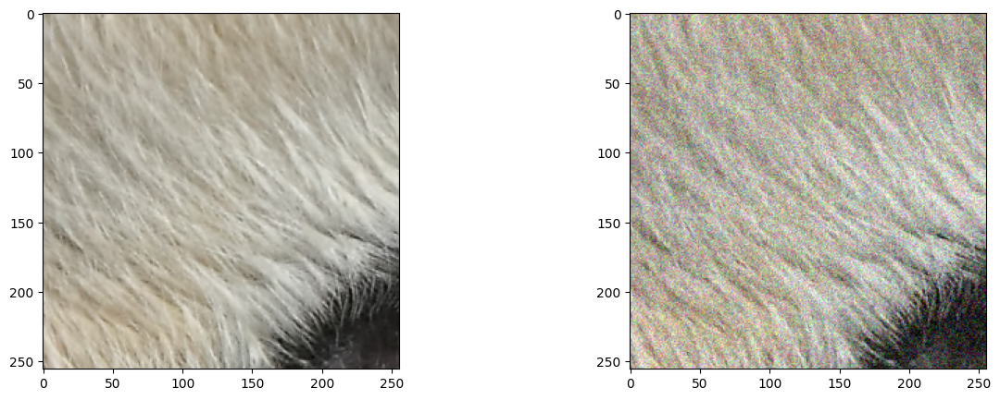

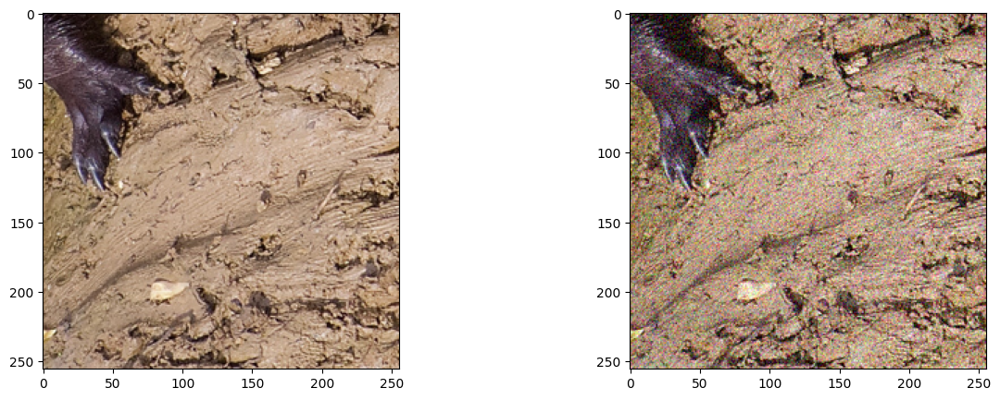

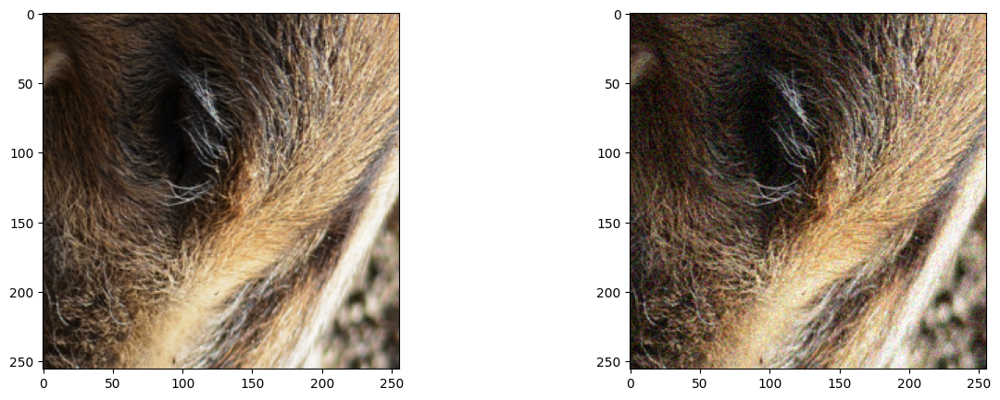

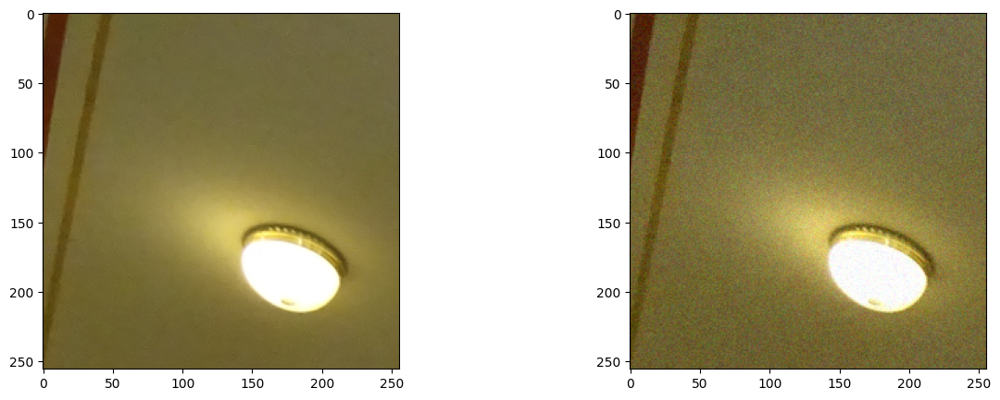

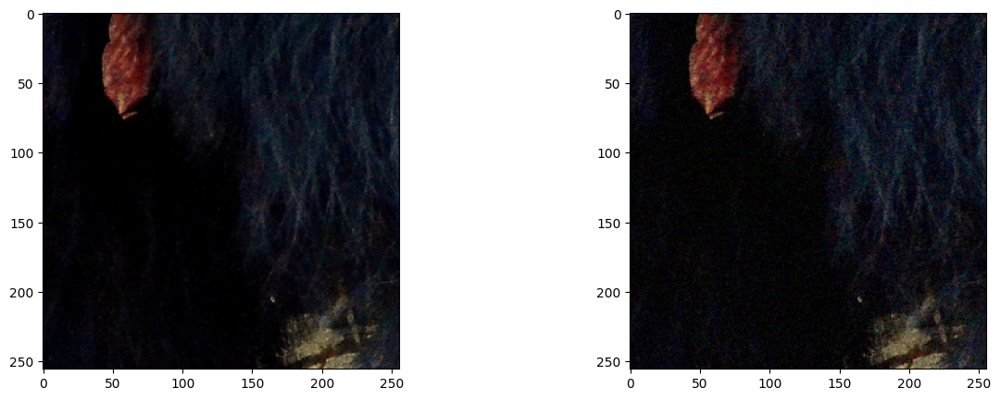

...

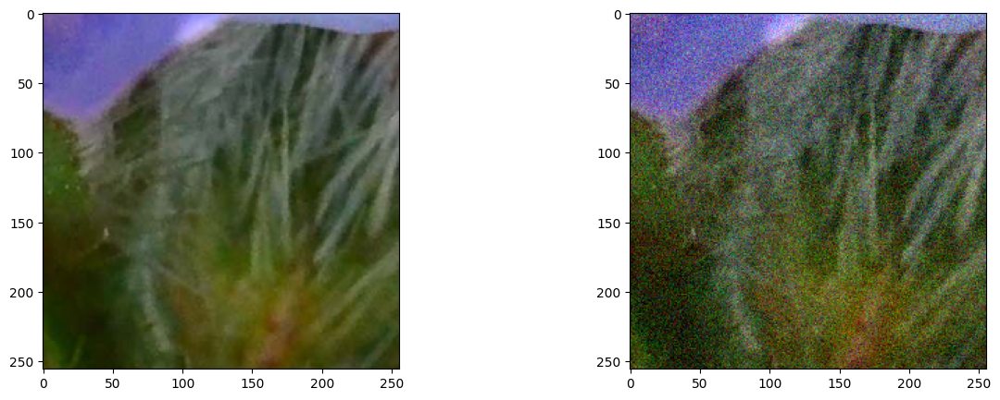

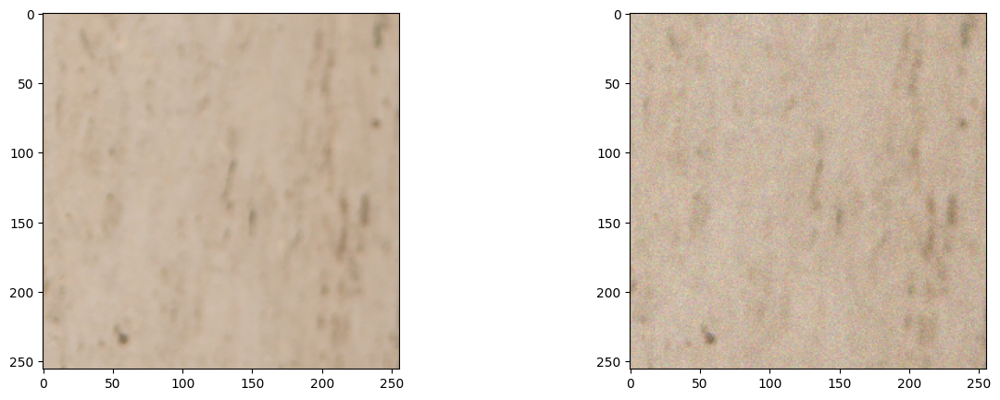

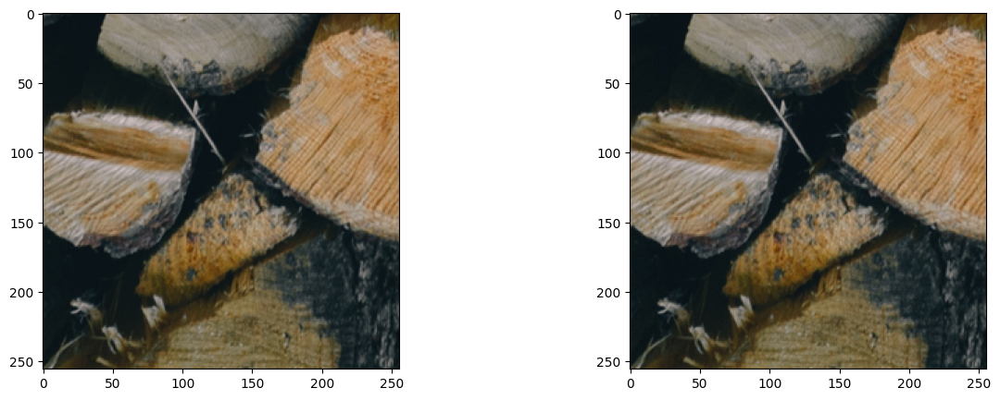

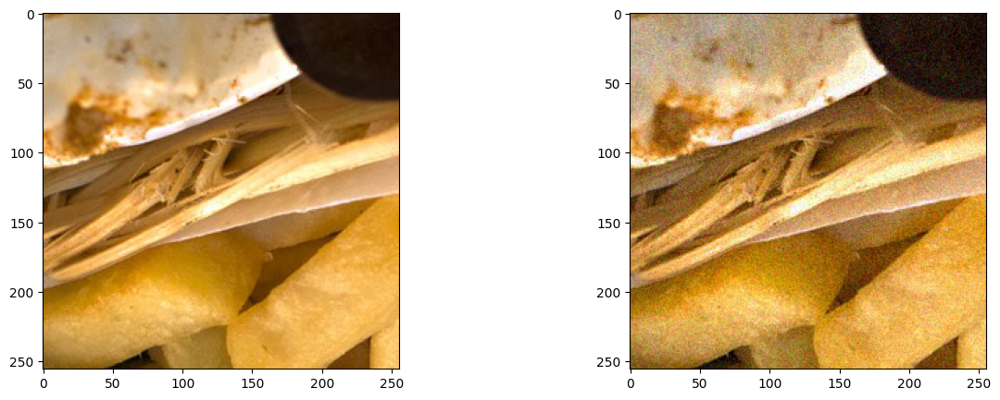

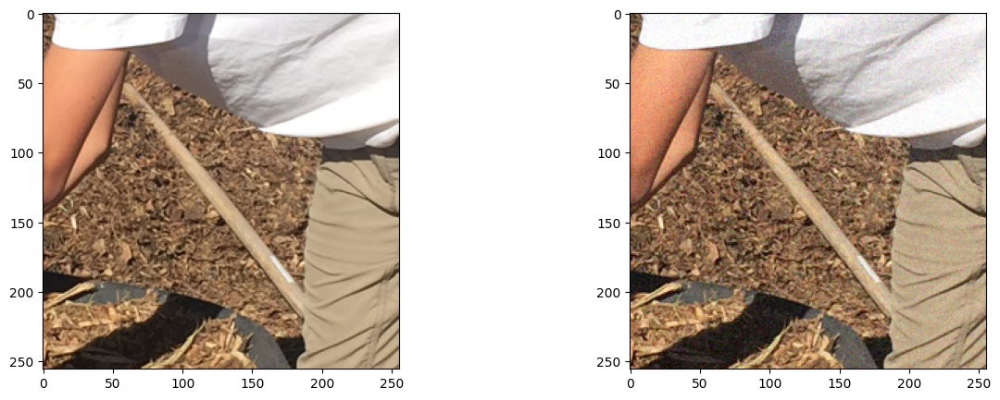

In [26]:

for B in range(20):
    img_true = np.clip(patchs_true[B].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
    img_noisy = np.clip(patchs_noisy[B].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)
    # img_recon = np.clip(reconstruct_patchs[B].cpu().numpy(), a_min=0.0, a_max=1.0).astype(np.float64)

    fig, axs = plt.subplots( ncols=2, nrows=1, figsize=(15, 5))
    axs[0].imshow(img_true)
    axs[1].imshow(img_noisy)
    # axs[2].imshow(img_recon)
    plt.show()

# 07

# 07

# 07

# 07